# Descriptive fit analysis

Last access (y.m.d): 21.06.17   
Last update (y.m.d): 20.06.17

In this notebook, I gather all V1 cells (data, model, descriptive fits) and analyze based on this complete set.

### Table of contents

- Initialize/gather
- Split the error: just for single gratings or just for mixtures (model)
- tuning shifts with contrast (descriptive)

## Initialize

In [556]:
import pandas as pd
import pdb
import warnings
warnings.filterwarnings('once')

In [538]:
import numpy as np
import os
import helper_fcns as hf
import model_responses as mr
from scipy.stats.mstats import gmean
from scipy.stats import ks_2samp, kstest
import itertools
import autoreload
import warnings
from IPython.core.display import display, HTML, Image

import seaborn as sns
# plt.style.use('https://raw.githubusercontent.com/paul-levy/SF_diversity/master/paul_plt_style.mplstyle');
import matplotlib.pyplot as plt
# plt.style.use('https://raw.githubusercontent.com/paul-levy/SF_diversity/master/paul_plt_style.mplstyle');
import matplotlib.cm as cm
import matplotlib.backends.backend_pdf as pltSave
%matplotlib inline
plt.style.use('https://raw.githubusercontent.com/paul-levy/SF_diversity/master/paul_plt_style.mplstyle');

# expDirs (and expNames must always be of the right length, i.e. specify for each expt dir 
expDirs = ['V1_orig/', 'altExp/', 'V1/']
expNames = ['dataList.npy', 'dataList.npy', 'dataList_glx.npy']

nExpts = len(expDirs);

# these are usually same for all expts...we'll "tile" below
# fitBase = 'fitList_190502cA';
fitBase = 'fitList_190513cA';
fitNamesWght = ['%s_wght_chiSq.npy' % fitBase];
fitNamesFlat = ['%s_flat_chiSq.npy' % fitBase];
dogNames = ['descrFits_190503_poiss_sach.npy'];
descrMod = 0; # which model for the diff. of gauss fits (0/1/2: flex/sach/tony)
descrNames = ['descrFits_190503_poiss_flex.npy'];
rvcNames   = ['rvcFits_f0.npy'];
# pack to easily tile
expt = [expDirs, expNames, fitNamesWght, fitNamesFlat, descrNames, dogNames, rvcNames];
for exp_i in range(len(expt)):
    if len(expt[exp_i]) == 1:
        expt[exp_i] = expt[exp_i] * nExpts;
# now unpack for use
expDirs, expNames, fitNamesWght, fitNamesFlat, descrNames, dogNames, rvcNames = expt;

base_dir = os.getcwd() + '/';

saveName = 'figures/2019_VSS/' # for one save name for all figures
save_loc = base_dir + saveName;

In [539]:
# Before any plotting, fix plotting paramaters
plt.style.use('https://raw.githubusercontent.com/paul-levy/SF_diversity/master/paul_plt_style.mplstyle');
from matplotlib import rcParams
rcParams['font.size'] = 20;
rcParams['pdf.fonttype'] = 42 # should be 42, but there are kerning issues                                                                                                                                                                                                    
rcParams['ps.fonttype'] = 42 # should be 42, but there are kerning issues                                                                                                                                                                                                     

rcParams['lines.linewidth'] = 2.5;
rcParams['lines.markeredgewidth'] = 0; # no edge, since weird tings happen then
rcParams['axes.linewidth'] = 1.5;
rcParams['lines.markersize'] = 5;

rcParams['xtick.major.size'] = 15
rcParams['xtick.minor.size'] = 8
rcParams['ytick.major.size'] = 15
rcParams['ytick.minor.size'] = 8

rcParams['xtick.major.width'] = 5
rcParams['xtick.minor.width'] = 2
rcParams['ytick.major.width'] = 5
rcParams['ytick.minor.width'] = 2

rcParams['font.style'] = 'oblique';
rcParams['font.size'] = 20;

## Gather data

Now, let's create a large list which will combine data/fits/analyses from all cells for all of the above experiments. For each cell, let's keep track of:
* "meta" parameters:
    * which experiment directory
    * which dataList, fitList, descrFit, rvcFit
    * which cell number within those lists
    * which experiment index?
    * which stimulus values (i.e. dispersions, sfs, contrasts)
* inferred parameters:
    * prefSf (for all conditions), along with % var explained
    * c50 (again, for all conditions)
* model parameters
    * fit parameters, loss value for weighted and flat

In [545]:
# what do we want to track for each cell?
jointList = []; # we'll pack dictionaries in a list...

# any parameters we need for analysis below?
varExplThresh = 75; # i.e. only include if the fit explains >X (e.g. 75)% variance
dog_varExplThresh = 60; # i.e. only include if the fit explains >X (e.g. 75)% variance

sf_range = [0.01, 10]; # allowed values of 'mu' for fits - see descr_fit.py for details

conDig = 1; # i.e. round to nearest tenth (1 decimal place)

muLoc = 2; # mu is in location '2' of parameter arrays
c50Loc = 2; # c50 is in location 2 of parameter arrays

rawInd = 0; # when computing diffs/ratios, "0" will be the raw value difference
ratioInd = 1; # "1" will be the index for the ratio/diff normalized by the log2 contrast change

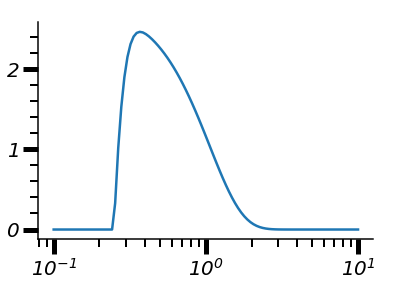

In [669]:
sfs_plot = np.geomspace(0.1, 10, 100);
prms = [10, 0.3, 5, 0.3*8];
rsp = hf.DoGsach(*prms, sfs_plot)[0]
plt.semilogx(sfs_plot, rsp);

In [546]:
for expDir, dL_nm, fLW_nm, fLF_nm, dF_nm, dog_nm, rv_nm in zip(expDirs, expNames, fitNamesWght, fitNamesFlat, descrNames, dogNames, rvcNames):
    
    # get the current directory, load data list
    data_loc = base_dir + expDir + 'structures/';    
    dataList = hf.np_smart_load(data_loc + dL_nm);
    fitListWght = hf.np_smart_load(data_loc + fLW_nm);
    fitListFlat = hf.np_smart_load(data_loc + fLF_nm);
    descrFits = hf.np_smart_load(data_loc + dF_nm);
    dogFits = hf.np_smart_load(data_loc + dog_nm);
    rvcFits = hf.np_smart_load(data_loc + rv_nm);

    # Now, go through for each cell in the dataList
    nCells = len(dataList['unitName']);
    for cell_ind in range(nCells):
        
        ###########
        ### meta parameters      
        ###########
        # get experiment name, load cell
        expName = dataList['unitName'][cell_ind];
        expInd = hf.get_exp_ind(data_loc, expName)[0];
        cell = hf.np_smart_load(data_loc + expName + '_sfm.npy');
        # get stimlus values
        resps, stimVals, val_con_by_disp, _, _ = hf.tabulate_responses(cell, expInd);
    
        meta = dict([('fullPath', data_loc),
                    ('cellNum', cell_ind+1),
                    ('dataList', dL_nm),
                    ('fitListWght', fLW_nm),
                    ('fitListFlat', fLF_nm),
                    ('descrFits', dF_nm),
                    ('dogFits', dog_nm),
                    ('rvcFits', rv_nm),
                    ('expName', expName),
                    ('expInd', expInd),
                    ('stimVals', stimVals),
                    ('val_con_by_disp', val_con_by_disp)]);

        ###########
        ### inferred data measures
        ###########
        disps, cons, sfs = stimVals;
        nDisps, nCons, nSfs = [len(x) for x in stimVals];
        
        # set up the arrays we need to store analyses
        bwHalf = np.zeros((nDisps, nCons)) * np.nan;
        bw34 = np.zeros((nDisps, nCons)) * np.nan;
        pSf = np.zeros((nDisps, nCons)) * np.nan;
        sfVarExpl = np.zeros((nDisps, nCons)) * np.nan;
        c50 = np.zeros((nDisps, nSfs)) * np.nan;
        # including from the DoG fits
        dog_pSf = np.zeros((nDisps, nCons)) * np.nan;
        dog_varExpl = np.zeros((nDisps, nCons)) * np.nan;
        dog_charFreq = np.zeros((nDisps, nCons)) * np.nan;
        # including the difference/ratio arrays; where present, extra dim of len=2 is for raw/normalized-to-con-change values
        bwHalfDiffs = np.zeros((nDisps, nCons, nCons, 2)) * np.nan;
        bw34Diffs = np.zeros((nDisps, nCons, nCons, 2)) * np.nan;
        pSfRats = np.zeros((nDisps, nCons, nCons, 2)) * np.nan;
        pSfModRat = np.zeros((nDisps, 2)) * np.nan; # derived measure from descrFits (see dog_prefSf)
        c50Rats = np.zeros((nDisps, nSfs, nSfs)) * np.nan;
        # bwHalf, bw34, pSf evaluated from data at 1:.33 contrast (only for single gratings)
        diffsAtThirdCon = np.zeros((3, )) * np.nan;
        
        ## first, get mean/median/maximum response over all conditions
        respByCond = resps[0].flatten();
        mn_med_max = np.array([np.nanmean(respByCond), np.nanmedian(respByCond), np.nanmax(respByCond)])
        
        ## then, get the superposition ratio
        ### WARNING: WARNING: resps is WITHOUT any rvcAdjustment (computed above)
        if expInd != 1:
            predResps = resps[2];
            rvcFitsCurr = hf.get_rvc_fits(data_loc, expInd, cell_ind+1, rvcName='None');
            trialInf = cell['sfm']['exp']['trial'];
            spikes  = hf.get_spikes(trialInf, rvcFits=rvcFitsCurr, expInd=expInd);
            _, _, respOrg, respAll = hf.organize_resp(spikes, trialInf, expInd);

            respMean = respOrg;
            mixResp = respMean[1:nDisps, :, :].flatten();
            sumResp = predResps[1:nDisps, :, :].flatten();

            nan_rm = np.logical_and(np.isnan(mixResp), np.isnan(sumResp));
            hmm = np.polyfit(sumResp[~nan_rm], mixResp[~nan_rm], deg=1) # returns [a, b] in ax + b
            supr_ind = hmm[0];
        else:
#             print('not computing suppression index, since expInd=1')
            supr_ind = np.nan;
        
        for d in range(nDisps):
                       
            ## spatial frequency stuff
            for c in range(nCons):

                # first, DoG fit
                if cell_ind in dogFits:
                    try:
                        varExpl = dogFits[cell_ind]['varExpl'][d, c];
                        if varExpl > dog_varExplThresh:
                            # on data
                            dog_pSf[d, c] = dogFits[cell_ind]['prefSf'][d, c]
                            dog_charFreq[d, c] = dogFits[cell_ind]['charFreq'][d, c]
                            dog_varExpl[d, c] = varExpl;
                    except: # then this dispersion does not have that contrast value, but it's ok - we already have nan
                        pass 

                # then, non-DoG descr fit
                if cell_ind in descrFits:
                    try:
                        varExpl = descrFits[cell_ind]['varExpl'][d, c];
                        if varExpl > varExplThresh:
                            # on data
                            ignore, bwHalf[d, c] = hf.compute_SF_BW(descrFits[cell_ind]['params'][d, c, :], height=0.5, sf_range=sf_range)
                            ignore, bw34[d, c] = hf.compute_SF_BW(descrFits[cell_ind]['params'][d, c, :], height=0.75, sf_range=sf_range)
                            pSf[d, c] = descrFits[cell_ind]['params'][d, c, muLoc]
                            sfVarExpl[d, c] = varExpl;
                    except: # then this dispersion does not have that contrast value, but it's ok - we already have nan
                        pass 

            try:
                # Now, compute the derived pSf Ratio
                _, psf_model, opt_params = hf.dog_prefSfMod(descrFits[cell_ind], allCons=cons, disp=d, varThresh=varExplThresh, dog_model=descrMod)
                valInds = np.where(descrFits[cell_ind]['varExpl'][d, :] > varExplThresh)[0];
                if len(valInds) > 1:
                    extrema = [cons[valInds[0]], cons[valInds[-1]]];
                    logConRat = np.log2(extrema[1]/extrema[0]);
                    evalPsf = psf_model(*opt_params, con=extrema);
                    evalRatio = evalPsf[1]/evalPsf[0];
                    pSfModRat[d] = [np.log2(evalRatio), np.log2(evalRatio)/logConRat];
            except: # then likely, no rvc/descr fits...
                pass 
                    
            ## RVC stuff
            for s in range(nSfs):
                if cell_ind in rvcFits:
                    # on data
                    try:
                        c50[d, s] = rvcFits[cell_ind]['params'][d, s, c50Loc];
                    except: # then this dispersion does not have that SF value, but it's ok - we already have nan
                        pass
        
            ## Now, after going through all cons/sfs, compute ratios/differences
            # first, with contrast
            for comb in itertools.combinations(range(nCons), 2):
                # first, in raw values [0] and per log2 contrast change [1] (i.e. log2(highCon/lowCon))
                conChange = np.log2(cons[comb[1]]/cons[comb[0]]);

                diff = bwHalf[d,comb[1]] - bwHalf[d,comb[0]];
                bwHalfDiffs[d,comb[0],comb[1]] = [diff, diff/conChange];
                
                diff = bw34[d,comb[1]] - bw34[d,comb[0]];
                bw34Diffs[d,comb[0],comb[1]] = [diff, diff/conChange];

                # NOTE: For pSf, we will log2 the ratio, such that a ratio of 0 
                # reflects the prefSf remaining constant (i.e. log2(1/1)-->0)
                rat = pSf[d,comb[1]] / pSf[d,comb[0]];
                pSfRats[d,comb[0],comb[1]] = [np.log2(rat), np.log2(rat)/conChange];
                                
            # then, as function of SF
            for comb in itertools.permutations(range(nSfs), 2):
                c50Rats[d,comb[0],comb[1]] = c50[d,comb[1]] / c50[d,comb[0]]
                
            # finally, just get the straight-from-data ratio/diff evaluated from full to one-third contrast
            if d == 0: # i.e. single grats
                conInd = int(np.where(np.round(cons[val_con_by_disp[d]], conDig) == 0.3)[0]); # cast to int
                conToUse = val_con_by_disp[d][conInd];
                diffsAtThirdCon = np.array([bwHalfDiffs[d, conToUse, -1, rawInd],
                                         bw34Diffs[d, conToUse, -1, rawInd],
                                         pSfRats[d, conToUse, -1, rawInd]]);
              
        dataMetrics = dict([('bwHalf', bwHalf),
                           ('bw34', bw34),
                           ('pSf', pSf),
                           ('c50', c50),
                           ('dog_pSf', dog_pSf),
                           ('dog_charFreq', dog_charFreq),
                           ('dog_varExpl', dog_varExpl),
                           ('bwHalfDiffs', bwHalfDiffs),
                           ('bw34Diffs', bw34Diffs),
                           ('pSfRats', pSfRats),
                           ('pSfModRat', pSfModRat),
                           ('sfVarExpl', sfVarExpl),
                           ('c50Rats', c50Rats),
                           ('suppressionIndex', supr_ind),
                           ('diffsAtThirdCon', diffsAtThirdCon),
                           ('mn_med_max', mn_med_max)
                           ]);

        ###########
        ### model
        ###########
        try:
            nllW, paramsW = [fitListWght[cell_ind]['NLL'], fitListWght[cell_ind]['params']];
            nllF, paramsF = [fitListFlat[cell_ind]['NLL'], fitListFlat[cell_ind]['params']];
            # and other other future measures?

            model = dict([('NLL_wght', nllW),
                         ('params_wght', paramsW),
                         ('NLL_flat', nllF),
                         ('params_flat', paramsF)
                        ])
        except: # then no model fit!
            model = dict([('NLL_wght', np.nan),
                         ('params_wght', []),
                         ('NLL_flat', np.nan),
                         ('params_flat', [])
                        ])
        
        ###########
        ### now, gather all together in one dictionary
        ###########
        cellSummary = dict([('metadata', meta),
                           ('metrics', dataMetrics),
                           ('model', model)]);
        
        
        jointList.append(cellSummary)

/users/plevy/.conda/envs/lcv-python/lib/python3.6/site-packages/ipykernel_launcher.py:121: RuntimeWarning: invalid value encountered in greater


## Analyze error (mixtures _or_ single gratings)

**WARNING:** This section is slow.

In [547]:
holdType = 1; # 0 - hold out all dispersions; 1 - hold out single gratings

# we'll evaluate loss for flat/weighted models, using chiSq loss function
normType = [1, 2];
lossType = 4; # chiSq loss
lossVals = [[], []];

# for cell_i in np.array([75]): # for testing, just pick one...
for cell_i in range(len(jointList)):
    
    try:
        curr_cell = jointList[cell_i];
        curr_S = hf.np_smart_load(curr_cell['metadata']['fullPath'] + curr_cell['metadata']['expName'] + '_sfm.npy')
        expInd = curr_cell['metadata']['expInd'];

        flat, wght = curr_cell['model']['params_flat'], curr_cell['model']['params_wght'];
        prms = [flat, wght];


        #######
        ### now, let's compute the loss on the mixtures alone!
        #######

        ### first, let's get the conditions we want to hold out (i.e. disp=0)
        allDisps, allCons, allSfs = curr_cell['metadata']['stimVals'];
        val_con_by_disp = curr_cell['metadata']['val_con_by_disp'];

        holdoutConds = [];
        if holdType == 1: # then we're holding out single gratings (i.e. keeping only disps)
            holdDisps = np.array([0]);
        elif holdType == 0: # hold out all mixtures
            holdDisps = np.arange(1, len(allDisps))
        for holdoutDisp in holdDisps:
            val_cons = val_con_by_disp[holdoutDisp];
            for c in val_cons:
                val_sfs = hf.get_valid_sfs(curr_S, holdoutDisp, c, expInd);
                for v in val_sfs:
                    holdoutCurr = [holdoutDisp, c, v];
#                     print('holding out d/c/v: %d/%d/%d' % (holdoutDisp,c,v));                                                                                                                                                                                                                     
#                     print('\tholding out d/c/v: %d/%.2f/%.2f' % (allDisps[holdoutDisp],allCons[c],allSfs[v]));                                                                                                                                                                                    
                    holdoutConds.append(holdoutCurr);
                    
        ### then, get the trials to which those conditions correspond
        # we'll create a mask - if True, then we skip that trial
        trial_inf = curr_S['sfm']['exp']['trial'];
        stimOr = np.vstack(trial_inf['ori']);
        # to start with, get rid of trials that are NaN (i.e. set mask to True for that trial)...
        mask = np.isnan(np.sum(stimOr, 0));

        if expInd == 1: # i.e. only for original experiment, remove ori tuning trials
            # and get rid of ori (only applies for expInd=1)
            oriBlockIDs = np.hstack((np.arange(131, 155+1, 2), np.arange(132, 136+1, 2)));  
            oriInds = np.empty((0,));
            for iB in oriBlockIDs: # will be skipped if expInd != 1
                indCond = np.where(trial_inf['blockID'] == iB);
                if len(indCond[0]) > 0:
                    oriInds = np.append(oriInds, indCond);
            mask[oriInds.astype(np.int64)] = True

        # finally, mask the holdout trials
        for cond in holdoutConds: # i.e. we pass in as array of [disp, con, sf] combinations
            val_trials = hf.get_valid_trials(curr_S, cond[0], cond[1], cond[2], expInd)[0];
            mask[val_trials] = True; # as in, don't include those trials either! 

       # now, compute the loss on the non-held out data!
        for prm, normTyp, lss in zip(prms, normType, lossVals):
            NLL = mr.SFMGiveBof(prm, curr_S, normType=normTyp, lossType=lossType, maskIn=~mask, expInd=expInd, rvcFits=None, trackSteps=False, overwriteSpikes=None)[0];
            lss.append(NLL);
            
    except:
        lossVals[0].append(np.nan);
        lossVals[1].append(np.nan);

/arc/2.2/p1/plevy/SF_diversity/sfDiv-OriModel/sfDiv-python/model_responses.py:806: RuntimeWarning: Degrees of freedom <= 0 for slice.
  exp_responses = [expByCond.flatten(), numpy.nanvar(expAll, axis=3).flatten()];
/users/plevy/.conda/envs/lcv-python/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:874: RuntimeWarning: invalid value encountered in greater_equal
  return (self.a <= x) & (x <= self.b)
/users/plevy/.conda/envs/lcv-python/lib/python3.6/site-packages/scipy/stats/_distn_infrastructure.py:874: RuntimeWarning: invalid value encountered in less_equal
  return (self.a <= x) & (x <= self.b)
/arc/2.2/p1/plevy/SF_diversity/sfDiv-OriModel/sfDiv-python/helper_fcns.py:927: RuntimeWarning: invalid value encountered in true_divide
  rats = np.divide(data_resps[1], data_resps[0]);
/arc/2.2/p1/plevy/SF_diversity/sfDiv-OriModel/sfDiv-python/model_responses.py:207: RuntimeWarning: overflow encountered in power
  s     = pow(stimSf, dOrdSp) * numpy.exp(-dOrdSp/2 * pow(sfRel, 

In [548]:
nan_rm = lambda x: x[~np.isnan(x)]

#### Now, plot distribution of chiSq values evaluated either for only dispersions or only single grats

In [27]:
if holdType == 0:
    holdStr = 'flat';
elif holdType == 1:
    holdStr = 'disp' # i.e. looking only at disp or single
saveName = 'chiSq_%s_%s.pdf' % (fitBase, holdStr);

/users/plevy/.conda/envs/lcv-python/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in greater
/users/plevy/.conda/envs/lcv-python/lib/python3.6/site-packages/ipykernel_launcher.py:25: RuntimeWarning: invalid value encountered in less


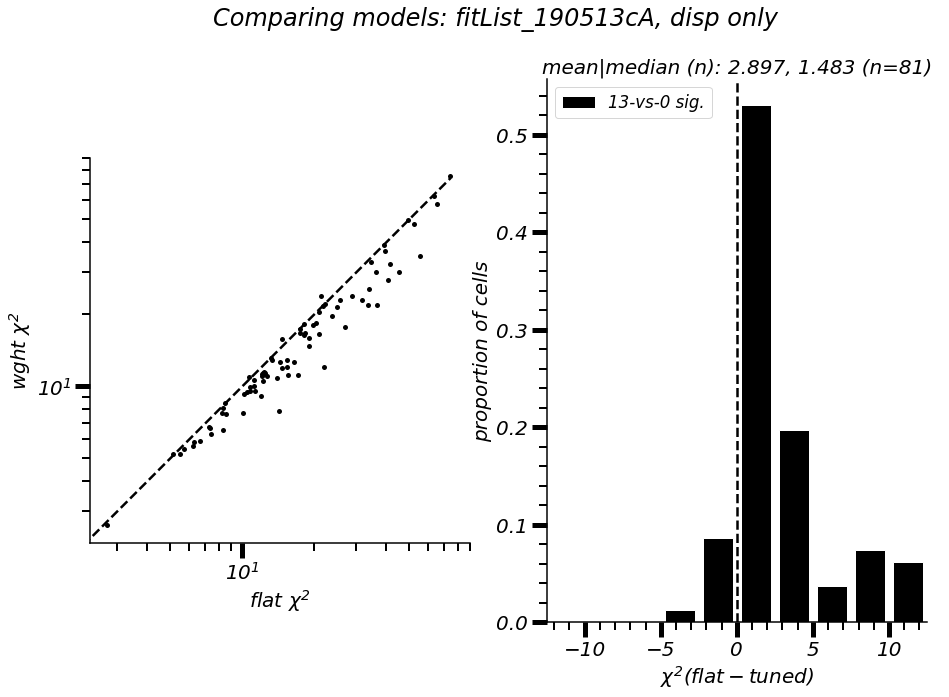

In [29]:
f, ax = plt.subplots(1, 2, figsize=(15, 10))

ax[0].loglog(nan_rm(np.array(lossVals[0])), nan_rm(np.array(lossVals[1])), 'o', c='k');
ax[0].axis('square');
ax[0].plot([0, np.nanmax(lossVals[0])], [0, np.nanmax(lossVals[0])], 'k--')
ax[0].set_xlabel(r'flat $\chi^2$');
ax[0].set_ylabel(r'wght $\chi^2$');

chi_diff = np.array(lossVals[0]) - np.array(lossVals[1]); # flat - wght

# plot chi^2 values (un-normalized)
width = 2

# for chiSq distribution plot
bins = np.linspace(-12.5, 12.5, 11);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
chiSqClipped = np.clip(chi_diff, bins[0]+0.5*stepSize, bins[-1]-0.5*stepSize)

tickVals = np.linspace(bins[1], bins[-2], 5);

counts, hist = np.histogram(nan_rm(chiSqClipped), bins=bins);
ax[1].axvline(0, ls='--', color='k')
sigCrit = 5.991; # magic number...from chi^2 dist, p<0.5
ax[1].bar(binPlotLocs, counts/len(nan_rm(chiSqClipped)), width=width, align='center', color='k', label='%d-vs-%d sig.' % (np.sum(chi_diff>sigCrit), np.sum(chi_diff<-sigCrit)));
ax[1].set_title('mean|median (n): %.3f, %.3f (n=%d)' % (np.nanmean(chi_diff), np.nanmedian(chi_diff), len(nan_rm(chi_diff))));
ax[1].legend(fontsize='small');
ax[1].set_xlabel(r'$\chi^2 (flat - tuned)$');
ax[1].set_ylabel('proportion of cells');
ax[1].set_xlim([bins[0], bins[-1]])
ax[1].set_xticks(tickVals);

plt.suptitle('Comparing models: %s, %s only' % (fitBase, holdStr));

if not os.path.exists(save_loc):
    os.makedirs(save_loc)
pdfSv = pltSave.PdfPages(save_loc + saveName);
pdfSv.savefig(f) # only one figure here...
pdfSv.close()

## Investigate tuning shifts with contrast: model

As an example, let's simulate from model to get ratio of exc. to norm pool atrangeof freq.

In [550]:
normalize = lambda x: np.divide(x, np.max(x));
# zTO1      = lambda x:
pSfRats = [jointList[i]['metrics']['pSfModRat'][0][0] for i in range(len(jointList))]
inds = list(reversed(np.argsort(pSfRats)))

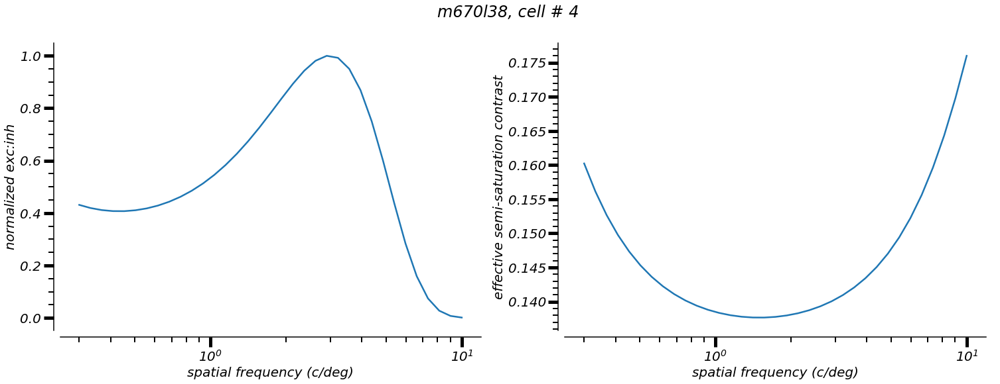

In [83]:
# example with flat normalization...

exCell = jointList[inds[16]];

sfSteps = 35;
disp = 0; # singlegrats
nmType = 2; # weighted (2) or flat (1)
if nmType == 1:
    params = exCell['model']['params_flat']
elif nmType == 2:
    params = exCell['model']['params_wght']

expInd = exCell['metadata']['expInd']
cellStr = hf.np_smart_load(exCell['metadata']['fullPath'] + exCell['metadata']['expName'] + '_sfm.npy');
con = exCell['metadata']['val_con_by_disp'][0][-1]; # i.e. single grats, high con
sfSim = np.geomspace(exCell['metadata']['stimVals'][2][0], exCell['metadata']['stimVals'][2][-1], 35);

fullResp, inh, exc, denom = [], [], [], []
for sf in sfSim:
    rf, i, e, dnm = mr.SFMsimulateNew(params, cellStr, disp, con, np.array([sf]), normType = nmType, expInd=expInd)
    fullResp.append(np.mean(rf));
    inh.append(np.mean(i));
    exc.append(np.mean(e));
    denom.append(np.mean(dnm));

f, ax = plt.subplots(1, 2, figsize=(25, 8))
c50_ind = 2;

plt.subplot(1, 2, 1)
plt.semilogx(sfSim, normalize(np.divide(normalize(exc), normalize(inh))));
plt.xlabel('spatial frequency (c/deg)')
plt.ylabel('normalized exc:inh')

plt.subplot(1, 2, 2)
plt.semilogx(sfSim, np.power(10, params[c50_ind]) + np.array(denom)-np.array(inh));
plt.xlabel('spatial frequency (c/deg)')
plt.ylabel('effective semi-saturation contrast')

f.suptitle('%s, cell # %d' % (exCell['metadata']['expName'], exCell['metadata']['cellNum']));
sns.despine(fig=f, offset=10);


In [4]:
# now the real thing

In [91]:
indsall = range(len(jointList))

In [92]:
inds = [67, 71, 59, 61, 62, 83, 14, 16];

In [93]:
indsog  = inds

**WARNING:** The below cell takes a long time (~1 hour or more?) to run - be careful.

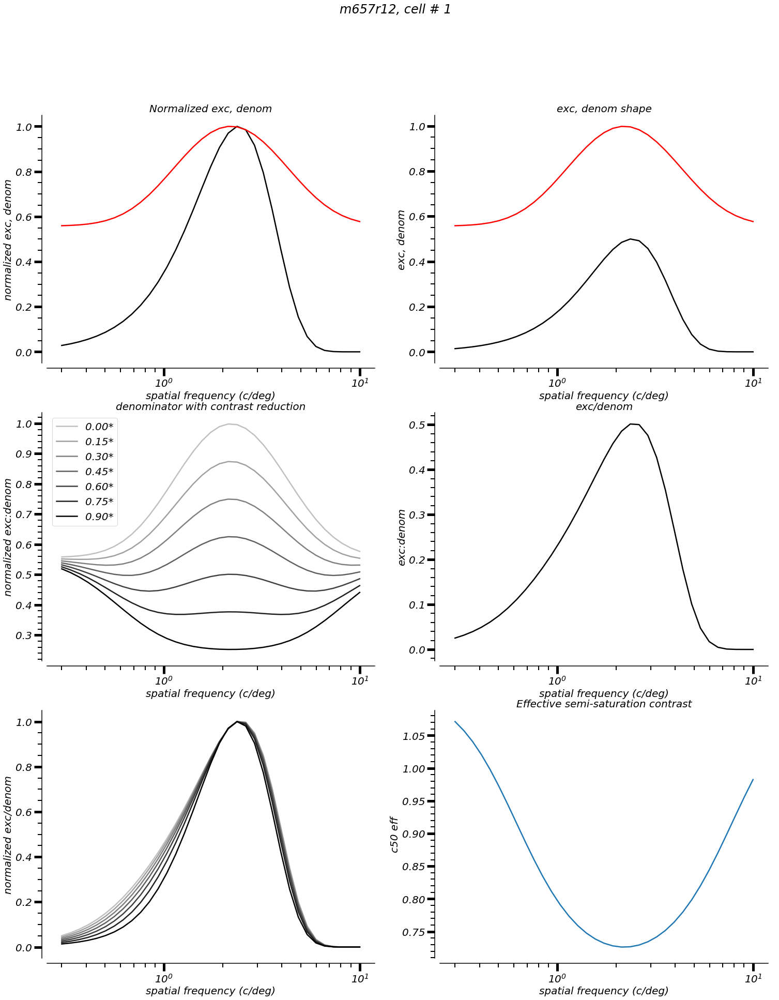

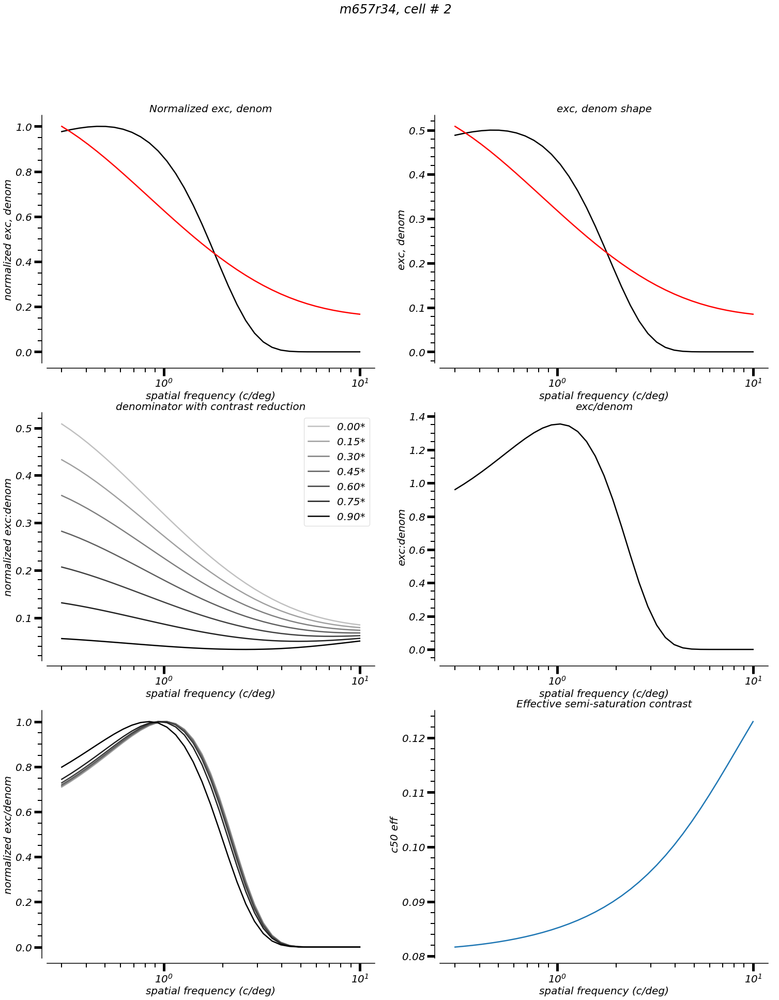

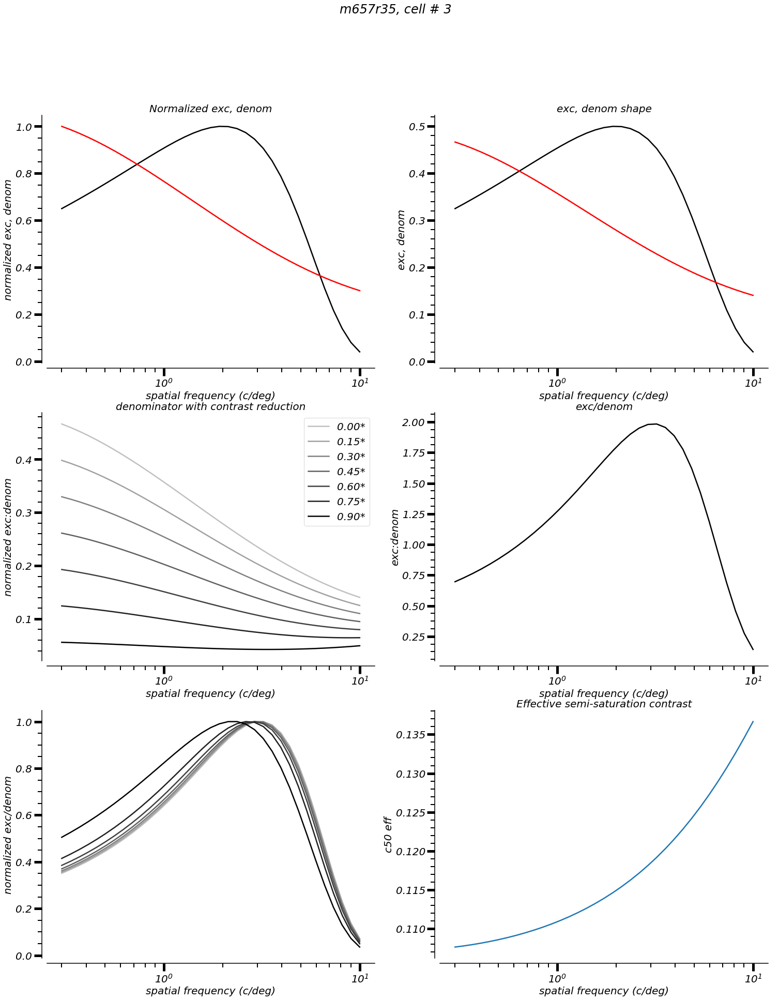

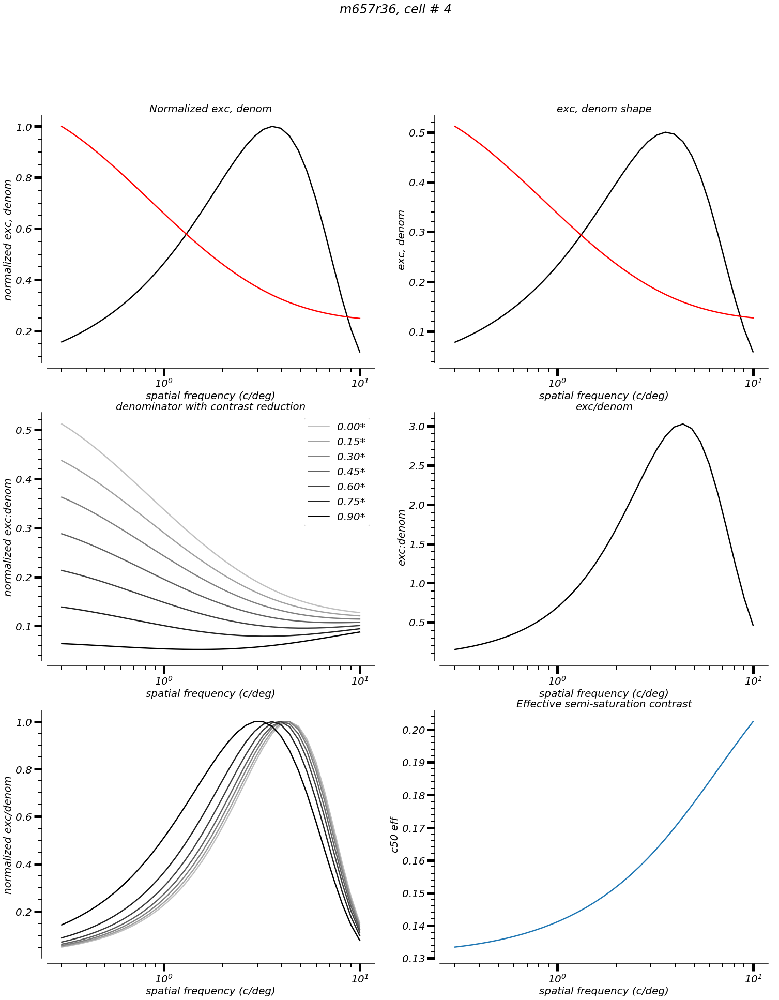

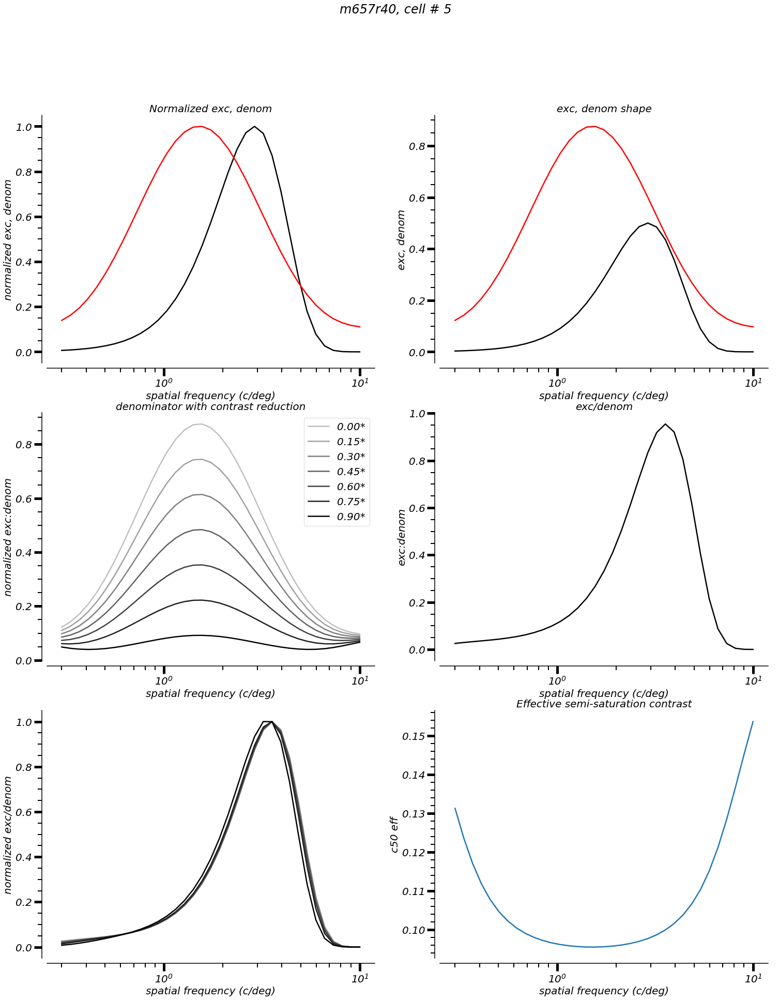

...

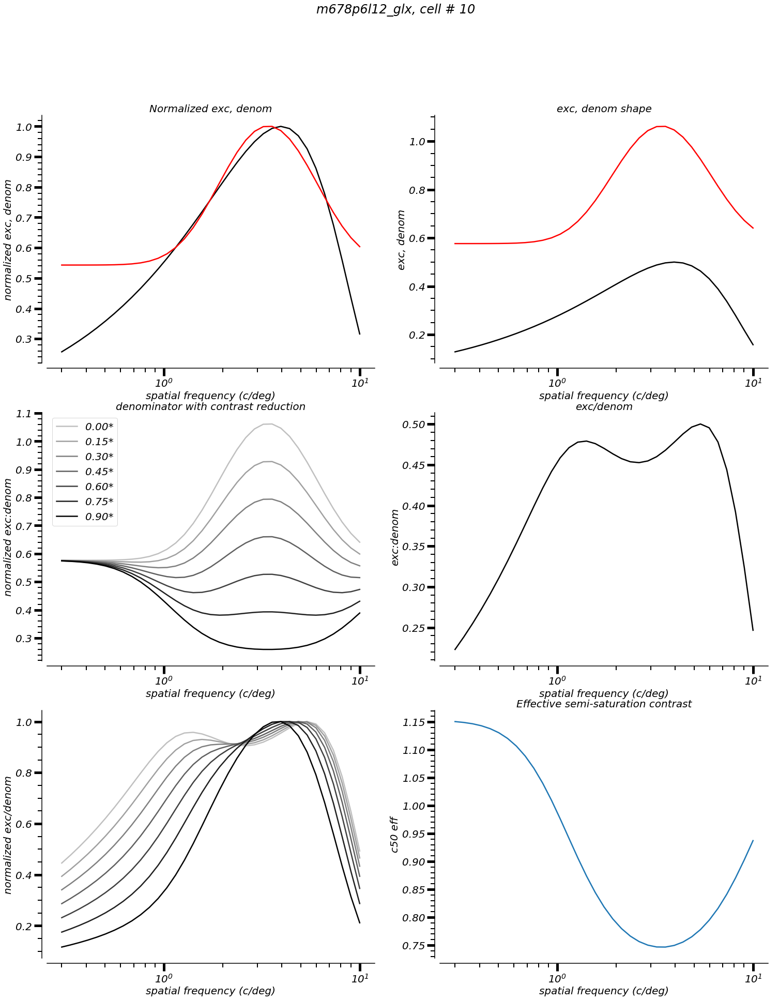

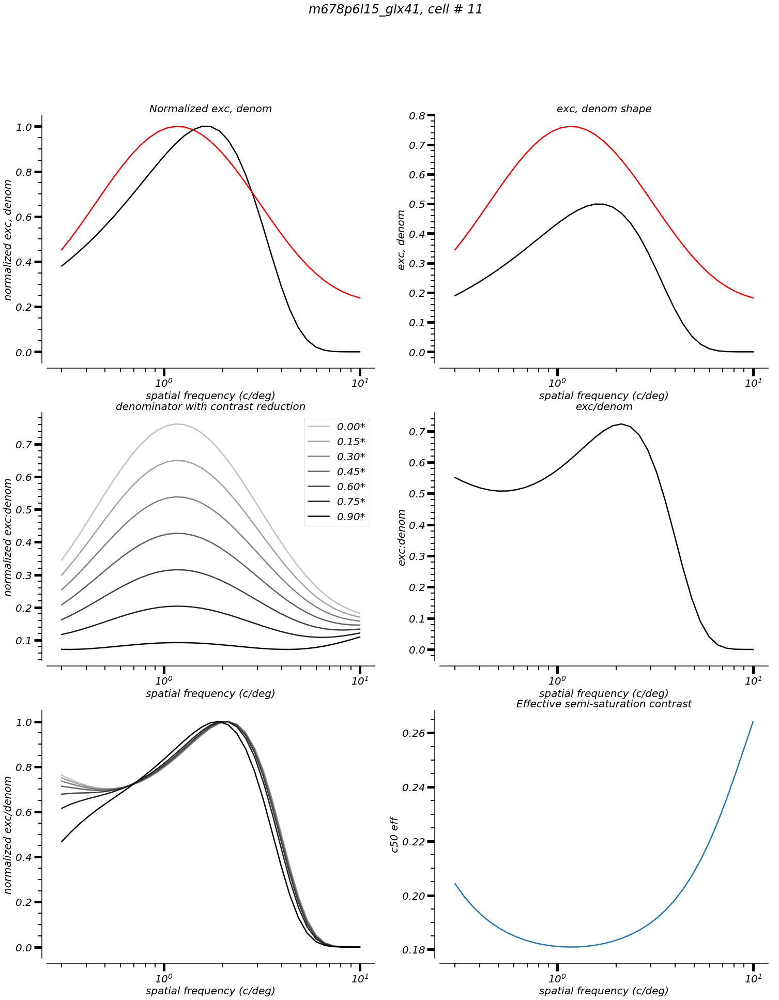

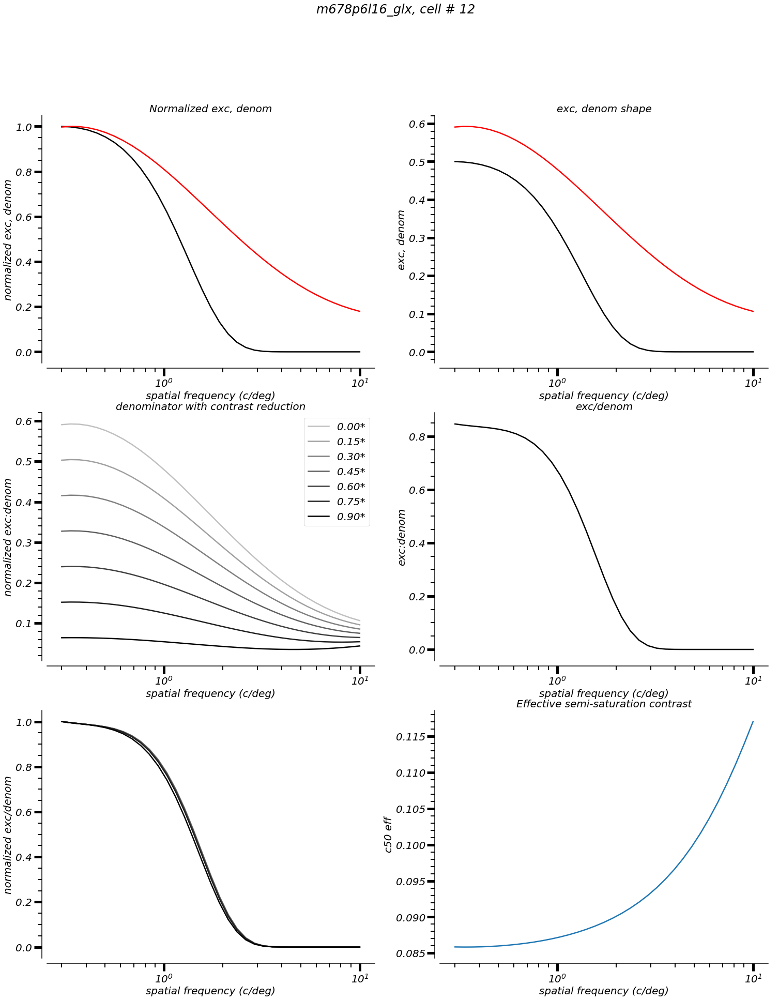

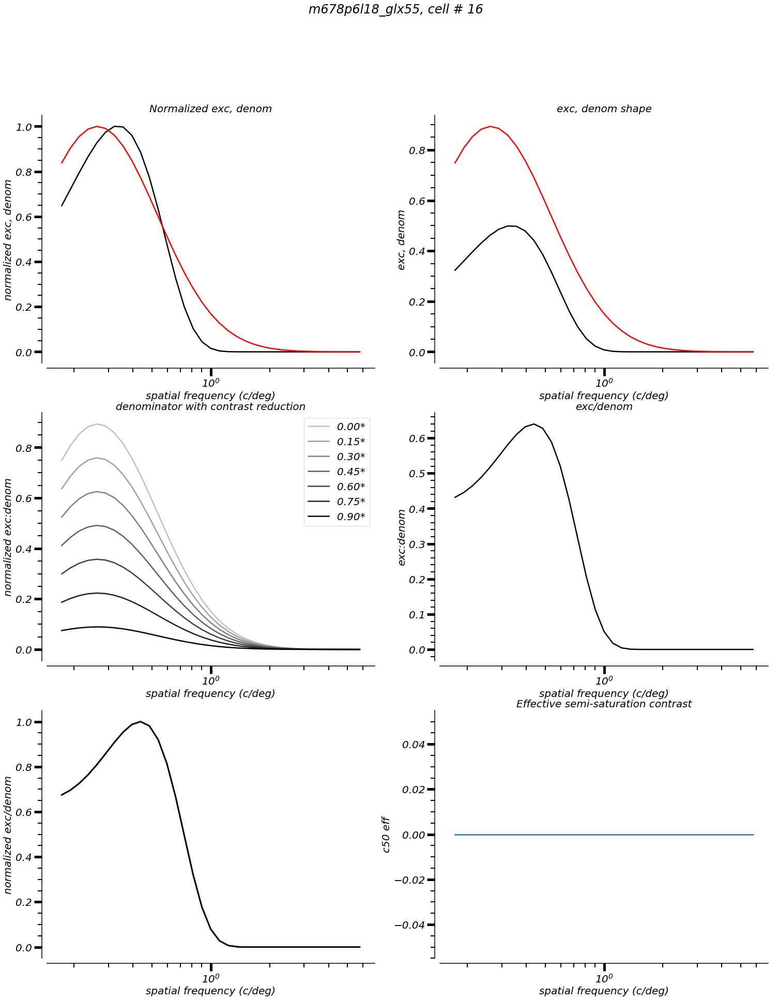

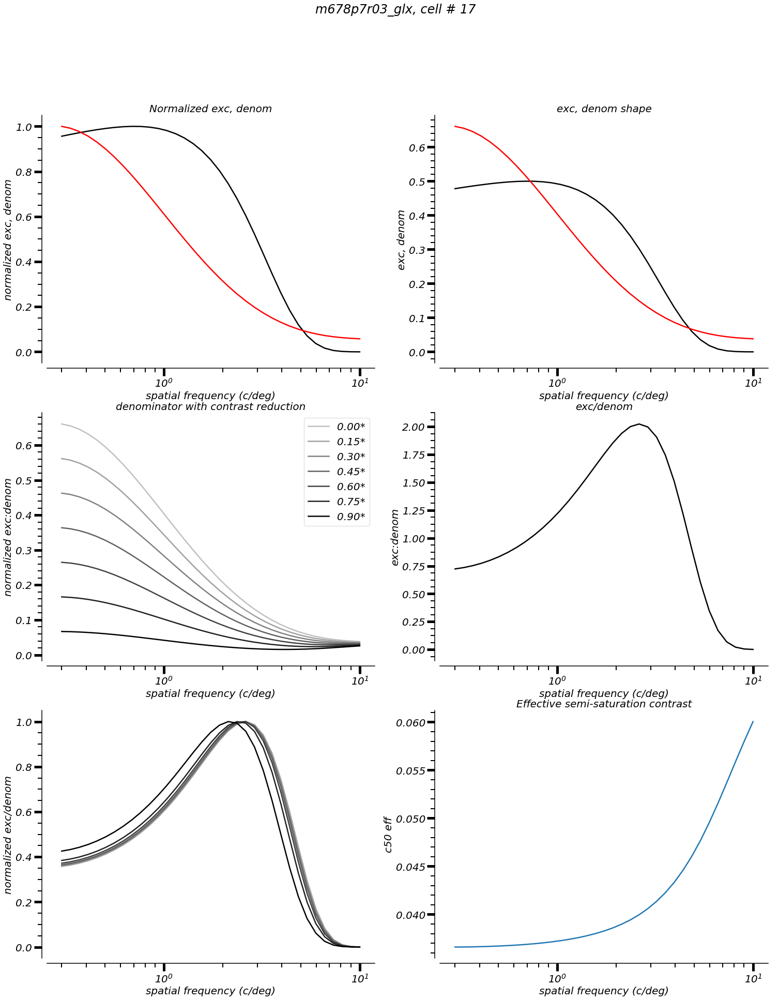

In [95]:
for ind in indsall:
    
    exCell = jointList[ind];

    try:

        sfSteps = 35;
        disp = 0; # singlegrats
        nmType = 2; # weighted

        expInd = exCell['metadata']['expInd']
        params = exCell['model']['params_wght']
        cellStr = hf.np_smart_load(exCell['metadata']['fullPath'] + exCell['metadata']['expName'] + '_sfm.npy');
        con = exCell['metadata']['val_con_by_disp'][0][-1]; # i.e. single grats, high con
        sfSim = np.geomspace(exCell['metadata']['stimVals'][2][0], exCell['metadata']['stimVals'][2][-1], 35);

        fullResp, inh, exc, denom = [], [], [], []
        for sf in sfSim:
            rf, i, e, dnm = mr.SFMsimulateNew(params, cellStr, disp, con, np.array([sf]), normType = nmType, expInd=expInd)
            fullResp.append(np.mean(rf));
            inh.append(np.mean(i));
            exc.append(np.mean(e));
            denom.append(np.mean(dnm));

        f, ax = plt.subplots(3, 2, figsize=(25, 30))
        c50_ind = 2;
        
        plt.subplot(3, 2, 2);
        plt.semilogx(sfSim, exc, 'k');
        plt.semilogx(sfSim, denom, 'r');
        plt.xlabel('spatial frequency (c/deg)')
        plt.ylabel('exc, denom')
        plt.title('exc, denom shape')
        
        plt.subplot(3, 2, 1)
        plt.semilogx(sfSim, normalize(exc), 'k');
        plt.semilogx(sfSim, normalize(denom), 'r');
        plt.xlabel('spatial frequency (c/deg)')
        plt.ylabel('normalized exc, denom')
        plt.title('Normalized exc, denom')

        plt.subplot(3, 2, 3);
        inhMult = np.linspace(0, 0.9, 7);
        shade = cm.gray(0.75 - 0.75*normalize(inhMult)) # i.e. darkest when mult is high, i.e. c50 matters least because response is high (higher con)
        lbls = ['%.2f*' % s for s in inhMult];
        [plt.semilogx(sfSim, denom-np.multiply(scl, inh), c=sh, label=lb) for scl, sh, lb in zip(inhMult, shade, lbls)];
        plt.xlabel('spatial frequency (c/deg)')
        plt.ylabel('normalized exc:denom')
        plt.title('denominator with contrast reduction')
        plt.legend();
        
        plt.subplot(3, 2, 4);
        plt.semilogx(sfSim, np.divide(exc, denom), 'k');
        plt.xlabel('spatial frequency (c/deg)')
        plt.ylabel('exc:denom')
        plt.title('exc/denom')        
        
        plt.subplot(3, 2, 5);
        inhMult = np.linspace(0, 0.9, 7);
        shade = cm.gray(0.75 - 0.75*normalize(inhMult)) # i.e. darkest when mult is high, i.e. c50 matters least because response is high (higher con)
        [plt.semilogx(sfSim, normalize(np.divide(normalize(exc), normalize(denom-np.multiply(scl, inh)))), c=sh) for scl, sh in zip(inhMult, shade)];
        plt.xlabel('spatial frequency (c/deg)')
        plt.ylabel('normalized exc/denom')

        plt.subplot(3, 2, 6)
        plt.semilogx(sfSim, np.power(10, params[c50_ind]) + np.array(denom)-np.array(inh));
        plt.xlabel('spatial frequency (c/deg)')
        plt.ylabel('c50 eff')
        plt.title('Effective semi-saturation contrast')

        
        f.suptitle('%s, cell # %d' % (exCell['metadata']['expName'], exCell['metadata']['cellNum']));
        sns.despine(fig=f, offset=10)
        
        sv_loc = save_loc + 'effectiveNorm/';
        sv_nm  = 'cell_%02d.pdf' % ind
        if not os.path.exists(sv_loc):
            os.makedirs(sv_loc)
        pdfSv = pltSave.PdfPages(sv_loc + sv_nm);
        pdfSv.savefig(f) # only one figure here...
        pdfSv.close()
        
    except:
        pass;

## Investigate tuning shifts with contrast: data

### Distribution of tuning measures

Here, let's look at the distribution of preferred spatial frequencies and bandwidths in the population.

Suppose we are looking at the preferred spatial frequency measure. Located within metrics, the measure is organized by dispersion (low to high), and within that, by contrast (again, low to high). Thus, jointList[x]['metrics']['pSf'][0][6] would have the preferred spatial frequency zero dispersion, 6th highest (0-indexed) contrast. Thus, to get the highest contrast, we index "-1" for the contrast (single gratings, only, since with newer versions of the experiment, the total contrast values of different dispersions differ slightly, and therefore occupy different locations in the list of total contrasts).

In [551]:
disp = 0;
con = -1; # highest for single gratings
pSfHighCon = np.array([jointList[i]['metrics']['pSf'][disp][con] for i in range(len(jointList))])
bwHalfHighCon = np.array([jointList[i]['metrics']['bwHalf'][disp][con] for i in range(len(jointList))])
bw34HighCon = np.array([jointList[i]['metrics']['bw34'][disp][con] for i in range(len(jointList))])

dog_pSfHighCon = np.array([jointList[i]['metrics']['dog_pSf'][disp][con] for i in range(len(jointList))])
dog_charFreqHighCon = np.array([jointList[i]['metrics']['dog_charFreq'][disp][con] for i in range(len(jointList))])

#### Cavanaugh dataset
Now, let's load the Cavanaugh (?) dataset sent to me by Tony

In [557]:
cv_file = 'v1-jrc-cavanaugh.xls'
df = pd.read_excel(cv_file);

In [585]:
# What are the columns?
df.keys()

Index(['Casename', 'AREA', 'PEN     ', 'HEMI    ', 'DEPTH   ', 'LAYER   ',
       'SCRDIST ', 'pixpercm', 'qual-OD      ', 'qual-rsp', 'qual-ISOL    ',
       'qual-rfx', 'qual-rfy', 'rfeccen', 'qual-rfsz', 'complexity',
       'class(s1,c0)', 'prefori', 'direct', 'oriwid', 'vectprefori',
       'vectprefdir', 'vectoribias', 'vectdirbias', 'optsf', 'sfwid', 'sfqual',
       'opttf', 'tfwid', 'tfqual', 'dataoptszdg', 'fitoptszdg', 'dsuprsp',
       'datasuppidx', 'fitsuppidx'],
      dtype='object')

In [609]:
### what do we want to get
# first, get the restricted set
eccBounds = [2, 6]
ecc_match = np.logical_and(df['rfeccen']>eccBounds[0], df['rfeccen']<eccBounds[1])
ecc_inds = np.where(ecc_match)[0]

# pref Sf
cav_psf = df['optsf'];
cav_psfEcc = df['optsf'][ecc_inds]

# sf BW
cav_sfBw = df['sfwid'];
cav_sfBwEcc = df['sfwid'][ecc_inds]

##### Cav: prefSF

In [610]:
bins = np.linspace(-2.5, 3.5, 13);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
clipLow, clipHigh = bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize;

psfs = [cav_psf, cav_psfEcc];
fitStr = ['full', 'ecc-match']

psfs_clipped = [np.clip(hf.nan_rm(np.log2(x)), clipLow, clipHigh) for x in psfs];
tickVals = np.linspace(bins[1], bins[-2], len(bins)-2)
# tickVals = np.linspace(bins[1]+0.5*stepSize, bins[-2]+0.5*stepSize, 10)

# calculate
nSF = [len(x) for x in psfs_clipped]
medianSF = [np.nanmedian(x) for x in psfs];
mnSF = [np.nanmean(x) for x in psfs];
gmnSF = [gmean(hf.nan_rm(x)) for x in psfs];

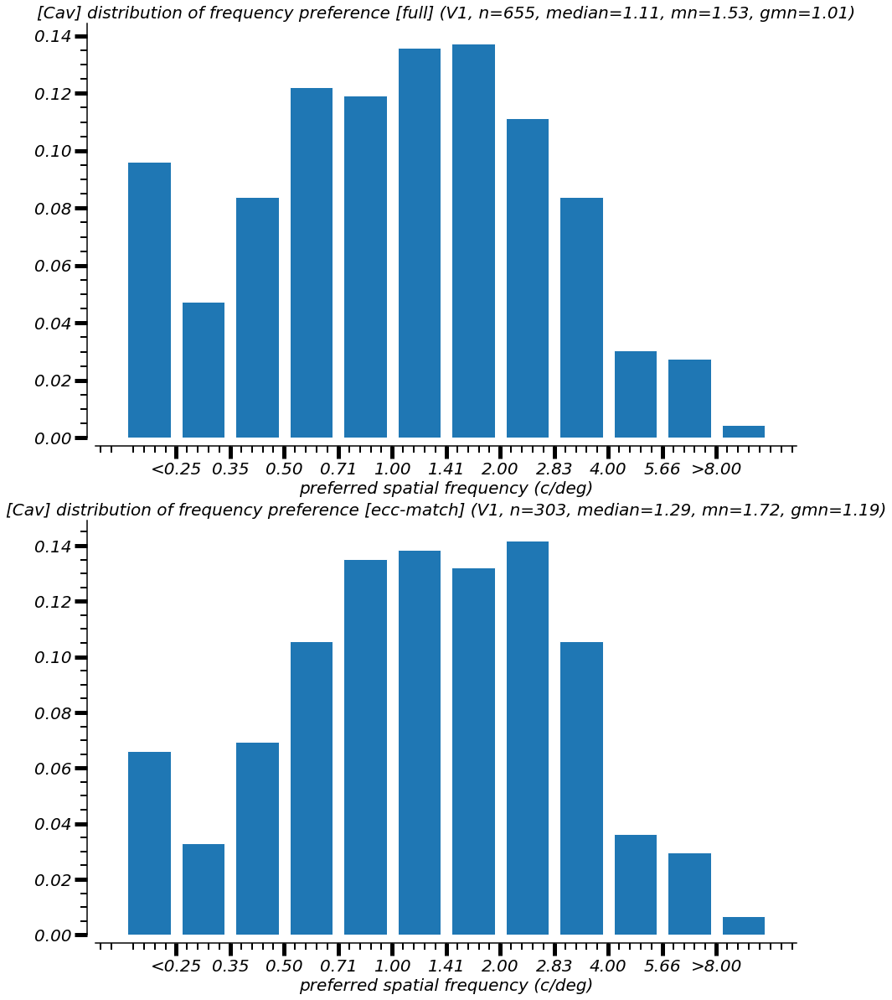

In [612]:
f, ax = plt.subplots(2, 1, figsize=(15, 2*10))
# ax.set(xscale="log")

for i in range(2):

    plt.subplot(2,1,1+i)
    vals, _ = np.histogram(psfs_clipped[i], bins=bins)
    vals_norm = vals/np.sum(vals)
    plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
    sns.despine(offset=10)
    tickStrs = ['%.2f' % np.power(2, x) for x in tickVals];
    tickStrs[0] = '<%s' % tickStrs[0];
    tickStrs[-1] = '>%s' % tickStrs[-1];
    plt.xticks(tickVals, tickStrs);

    plt.xlabel('preferred spatial frequency (c/deg)');
    plt.title('[Cav] distribution of frequency preference [%s] (V1, n=%d, median=%.2f, mn=%.2f, gmn=%.2f)' % (fitStr[i], nSF[i], medianSF[i], mnSF[i], gmnSF[i]));


##### Cav: bandwidth

First, we ask: are the bandwidths given in octaves or linear c/deg?

In [637]:
all_ok = np.logical_and(~np.isnan(cav_psf), ~np.isnan(cav_sfBw))
fit_mod = np.polyfit(cav_psf[all_ok], cav_sfBw[all_ok], deg=1)

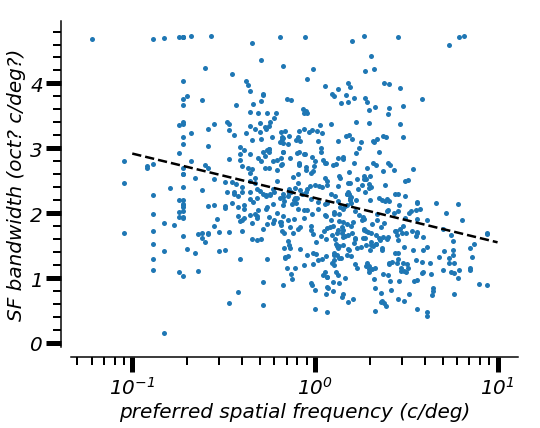

In [641]:
all_ok = np.logical_and(~np.isnan(cav_psf), ~np.isnan(cav_sfBw))
# returns a, b in a*x + b
fit_mod = np.polyfit(np.log2(cav_psf[all_ok]), cav_sfBw[all_ok], deg=1)

plt.subplots(figsize=(8, 6))
plt.plot(cav_psf, cav_sfBw, 'o')
# plot the linear fit on log-lin (x-y) coords.
all_sfs = np.geomspace(0.1, 10, 100);
plt.plot(all_sfs, np.log2(all_sfs)*fit_mod[0] + fit_mod[1], 'k--')
plt.xscale('log')
plt.xlabel('preferred spatial frequency (c/deg)')
plt.ylabel('SF bandwidth (oct? c/deg?)')
sns.despine(offset=10, trim=False)

The relative lack of (or even slightly negative) correlation between preferred spatial frequency and bandwidth measure suggests that the latter measure is given in octaves, not linear cycles per degree. Why? Well, neurons with higher preferred SF have a larger linear bandwidth, but generally octave bandwidth remains constant as a function of preferred SF.

In [616]:
bins = np.linspace(0, 6, 13);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
clipLow, clipHigh = bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize;

cv_sfBwOct = [hf.bw_lin_to_log(sfs[i]-bws[i]/2, sfs[i]+bws[i]/2)]

sfBWs = [cav_sfBw, cav_sfBwEcc];
fitStr = ['full', 'ecc-match']

bw_clipped = [np.clip(hf.nan_rm(x), clipLow, clipHigh) for x in sfBWs];
tickVals = np.linspace(bins[1], bins[-2], len(bins)-2)

# calculate
nBW = [len(x) for x in bw_clipped]
medianBW = [np.nanmedian(x) for x in sfBWs];
mnBW = [np.nanmean(x) for x in sfBWs];

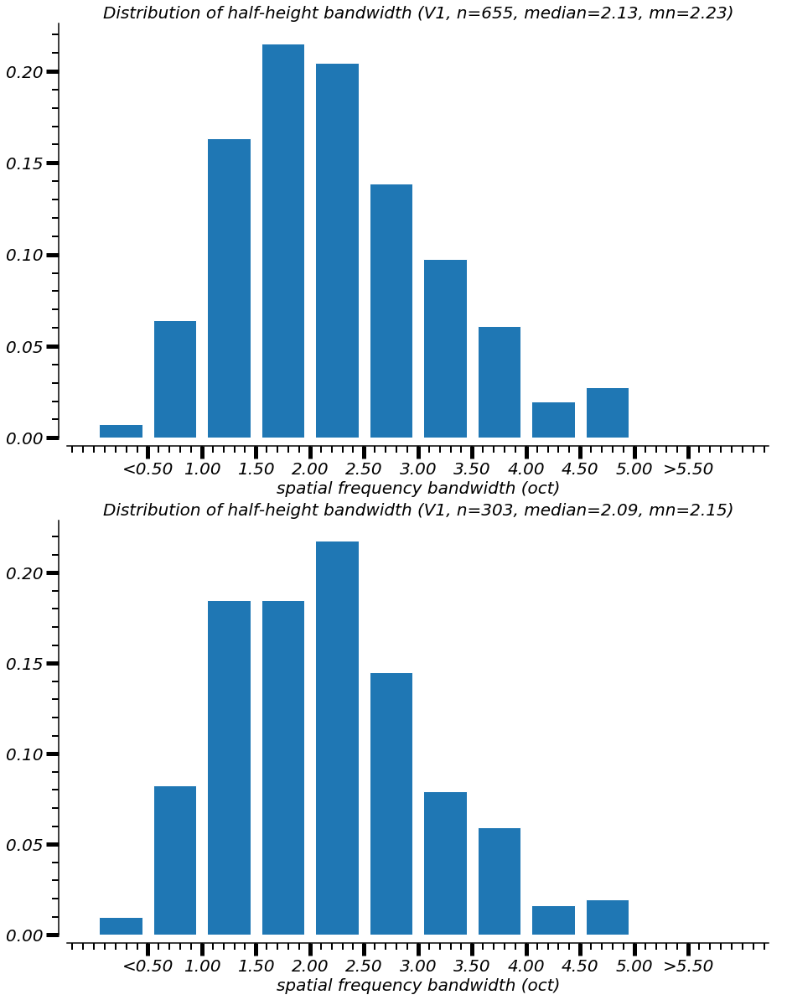

In [617]:
f, ax = plt.subplots(2, 1, figsize=(15, 2*10))
# ax.set(xscale="log")

for i in range(2):

    plt.subplot(2,1,1+i)
    vals, _ = np.histogram(bw_clipped[i], bins=bins)
    vals_norm = vals/np.sum(vals)
    plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
    sns.despine(offset=10)
    tickStrs = ['%.2f' % x for x in tickVals];
    tickStrs[0] = '<%s' % tickStrs[0];
    tickStrs[-1] = '>%s' % tickStrs[-1];
    plt.xticks(tickVals, tickStrs);

    plt.xlabel('spatial frequency bandwidth (oct)');
    plt.title('Distribution of half-height bandwidth (V1, n=%d, median=%.2f, mn=%.2f)' % (nBW[i], medianBW[i], mnBW[i]));

#### Plot the distribution of preferred frequency:

In [552]:
bins = np.linspace(-2.5, 3.5, 13);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
clipLow, clipHigh = bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize;

psfs = [pSfHighCon, dog_pSfHighCon];
fitStr = ['flex', 'DoG']

psfs_clipped = [np.clip(hf.nan_rm(np.log2(x)), clipLow, clipHigh) for x in psfs];
tickVals = np.linspace(bins[1], bins[-2], len(bins)-2)
# tickVals = np.linspace(bins[1]+0.5*stepSize, bins[-2]+0.5*stepSize, 10)

# calculate
nSF = [len(x) for x in psfs_clipped]
medianSF = [np.nanmedian(x) for x in psfs];
mnSF = [np.nanmean(x) for x in psfs];
gmnSF = [gmean(hf.nan_rm(x)) for x in psfs];

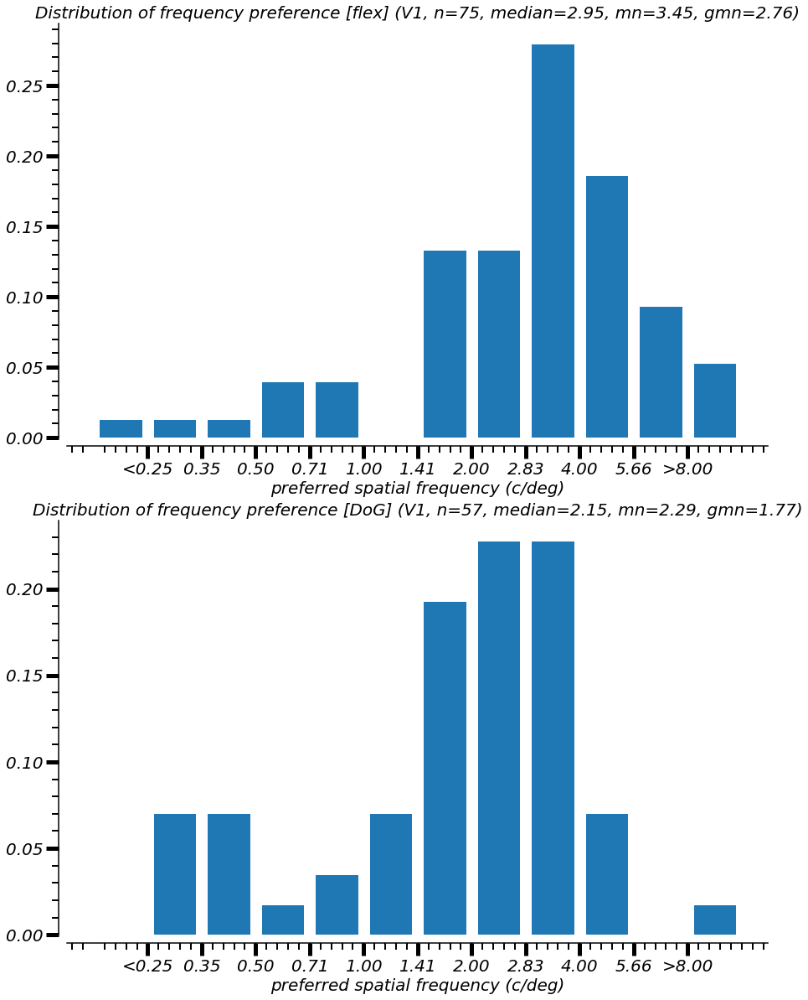

In [553]:
f, ax = plt.subplots(2, 1, figsize=(15, 2*10))
# ax.set(xscale="log")

for i in range(2):

    plt.subplot(2,1,1+i)
    vals, _ = np.histogram(psfs_clipped[i], bins=bins)
    vals_norm = vals/np.sum(vals)
    plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
    sns.despine(offset=10)
    tickStrs = ['%.2f' % np.power(2, x) for x in tickVals];
    tickStrs[0] = '<%s' % tickStrs[0];
    tickStrs[-1] = '>%s' % tickStrs[-1];
    plt.xticks(tickVals, tickStrs);

    plt.xlabel('preferred spatial frequency (c/deg)');
    plt.title('Distribution of frequency preference [%s] (V1, n=%d, median=%.2f, mn=%.2f, gmn=%.2f)' % (fitStr[i], nSF[i], medianSF[i], mnSF[i], gmnSF[i]));


##### Compare to existing measurements:

**DeValois, Albrecht, Thorell (1982):**
Here, they split their data by X&Y, foveal ($[0^{\circ}, 1.5^{\circ}]$) and parafoveal ($[3^{\circ}, 5^{\circ}]$). Our data are parafoveal if not further, so we expect that our distribution of peak frequencies will be comparable to their X/Y parafoveal data, if not shifted lower, since we expect a fall-off in peak frequency with eccentricity (i.e., the highest peak frequency drops as a function of eccentricity, [DeValois & DeValois, 1980]). They have a mean of 2.2/3.2 cpd for Y/X parafoveal cells; our mean/gmean is 3.45/2.76 cpd. **Our cells are "in the ballpark".**

<img src="figures/dv-sf.png" width=400 />

**Cavanaugh (intra-lab dataset):**
See the above - his distribution has a substantially lower preferred spatial frequency (mean between 1.5 - 1.7 cpd, depending on full or eccentricity-matched dataset).

#### Plot the distribution of characteristic frequency:

In [554]:
bins = np.linspace(-0.5, 4.5, 11);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
clipLow, clipHigh = bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize;

char_clipped = np.clip(hf.nan_rm(np.log2(dog_charFreqHighCon)), clipLow, clipHigh);
tickVals = np.linspace(bins[1], bins[-2], len(bins)-2)
# tickVals = np.linspace(bins[1]+0.5*stepSize, bins[-2]+0.5*stepSize, 10)

# calculate
nCF = len(char_clipped)
medianCF = np.nanmedian(dog_charFreqHighCon)
mnCF = np.nanmean(dog_charFreqHighCon);
gmnCF = gmean(hf.nan_rm(dog_charFreqHighCon));

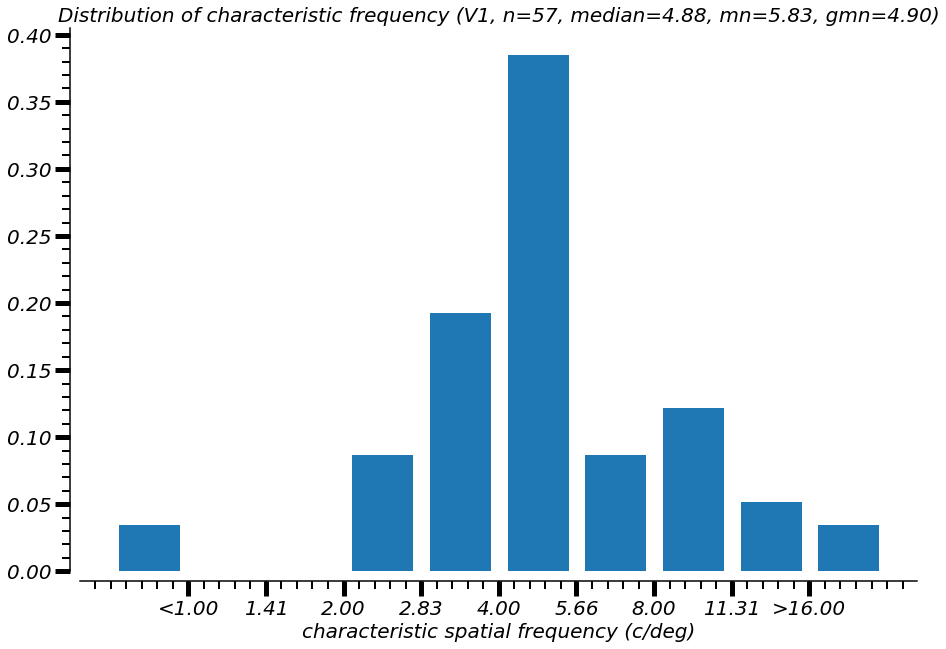

In [555]:
f, ax = plt.subplots(figsize=(15, 10))

vals, _ = np.histogram(char_clipped, bins=bins)
vals_norm = vals/np.sum(vals)
plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
sns.despine(offset=10)
tickStrs = ['%.2f' % np.power(2, x) for x in tickVals];
tickStrs[0] = '<%s' % tickStrs[0];
tickStrs[-1] = '>%s' % tickStrs[-1];
plt.xticks(tickVals, tickStrs);

plt.xlabel('characteristic spatial frequency (c/deg)');
plt.title('Distribution of characteristic frequency (V1, n=%d, median=%.2f, mn=%.2f, gmn=%.2f)' % (nCF, medianCF, mnCF, gmnCF));


#### Plot the distribution of frequency tuning bandwidth:

First, half-height

In [527]:
bins = np.linspace(0, 6, 13);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
clipLow, clipHigh = bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize;
bwHalfClipped = np.clip(hf.nan_rm(bwHalfHighCon), clipLow, clipHigh)
tickVals = np.linspace(bins[1], bins[-2], len(bins)-2)

# compute
nBW = len(bwHalfClipped);
medianBW = np.nanmedian(bwHalfHighCon);
mnBW = np.nanmean(bwHalfHighCon);

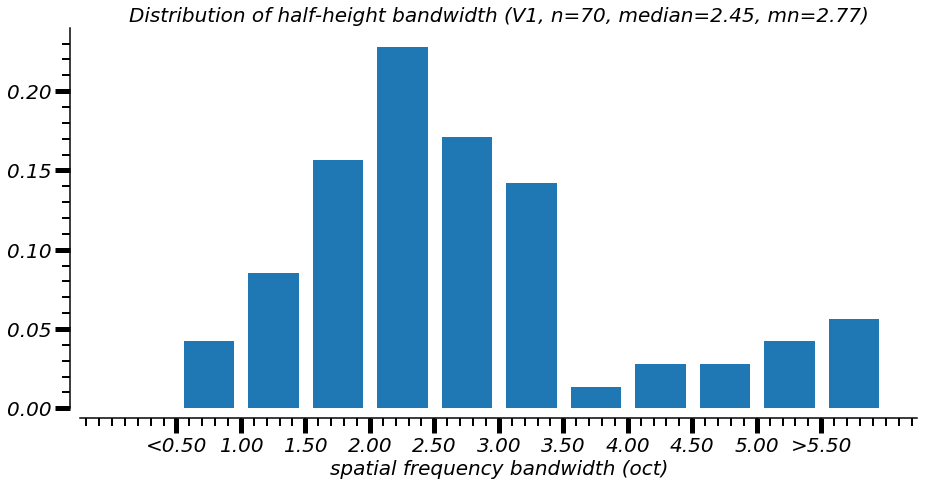

In [528]:
f, ax = plt.subplots(figsize=(15, 7))
# ax.set(xscale="log")

vals, _ = np.histogram(bwHalfClipped, bins=bins)
vals_norm = vals/np.sum(vals)
plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
sns.despine(offset=10)
tickStrs = ['%.2f' % x for x in tickVals];
tickStrs[0] = '<%s' % tickStrs[0];
tickStrs[-1] = '>%s' % tickStrs[-1];
plt.xticks(tickVals, tickStrs);

plt.xlabel('spatial frequency bandwidth (oct)');
plt.title('Distribution of half-height bandwidth (V1, n=%d, median=%.2f, mn=%.2f)' % (nBW, medianBW, mnBW));

#### Compare to existing measurements:

**DeValois, Albrecht, Thorell (1982):**
Here, they split their data by X&Y, foveal ($[0^{\circ}, 1.5^{\circ}]$) and parafoveal ($[3^{\circ}, 5^{\circ}]$). 
Our data are parafoveal if not further, so we expect that our distribution of bandwidth will be comparable to their X/Y parafoveal data. They have a mean of 1.6/1.32 octaves for Y/X parafoveal cells; our mean/median is 2.45/2.77 octaves. **Our cells are more broadly tuned. Why?**

<img src="figures/dv-bw.png" width=400 />

**Cavanaugh (intra-lab dataset):**
Our bandwidth measures are comparable (median/mean around 2.1/2.2 octaves), though ours are still broader. Note that we have assumed his measurements are given in octaves (and not linear CPD).

Then, three-fourth height

In [386]:
bins = np.linspace(0, 4, 13);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
clipLow, clipHigh = bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize;
bw34Clipped = np.clip(hf.nan_rm(bw34HighCon), clipLow, clipHigh)
tickVals = np.linspace(bins[1], bins[-2], len(bins)-2)

# compute
nBW = len(bw34Clipped);
medianBW = np.nanmedian(bw34HighCon);
mnBW = np.nanmean(bw34HighCon);

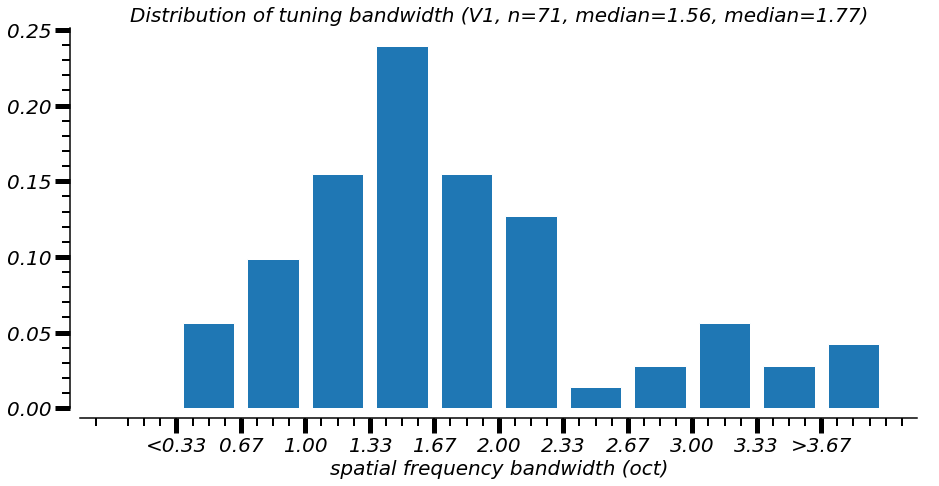

In [387]:
f, ax = plt.subplots(figsize=(15, 7))
vals, _ = np.histogram(bw34Clipped, bins=bins)
vals_norm = vals/np.sum(vals)
plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
sns.despine(offset=10)
tickStrs = ['%.2f' % x for x in tickVals];
tickStrs[0] = '<%s' % tickStrs[0];
tickStrs[-1] = '>%s' % tickStrs[-1];
plt.xticks(tickVals, tickStrs);

plt.xlabel('spatial frequency bandwidth (oct)');
plt.title('Distribution of 3/4-height bandwidth (V1, n=%d, median=%.2f, median=%.2f)' % (nBW, medianBW, mnBW));

### Preferred spatial frequency with contrast inferred from descriptive fit to pSf vs. con

Now, we plot the ratio of preferred spatial frequencies in the data set. Here, we are using "pSfModRat" - a derived measure in which we fit a simple polynomial equation to the preferred frequencies as a function of contrast (see descr_fits.py for details).

- In [0, 0], the ratio of preferred spatial frequencies ($\frac{con_a}{con_b}$) evaluated at the extrema contrasts
- In [0, 1], the ratio of preferred spatial frequencies is expressed per unit log2 contrast

In [343]:
saveName = 'sfAllConRatio_%s.pdf' % fitBase

# [0, 0] for single gratings, ratio
# [0, 1] for single gratings, ratio per unit log2 contrast
psfModRats = [jointList[i]['metrics']['pSfModRat'][0, 1] for i in range(len(jointList))];
psfModRats = np.array(psfModRats);

bins = np.linspace(-1.25, 1.25, 11);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
psfClipped = np.clip(psfModRats, bins[1]-0.5*stepSize, bins[-2]+0.5*stepSize)

tickVals = np.linspace(bins[1], bins[-2], 5);

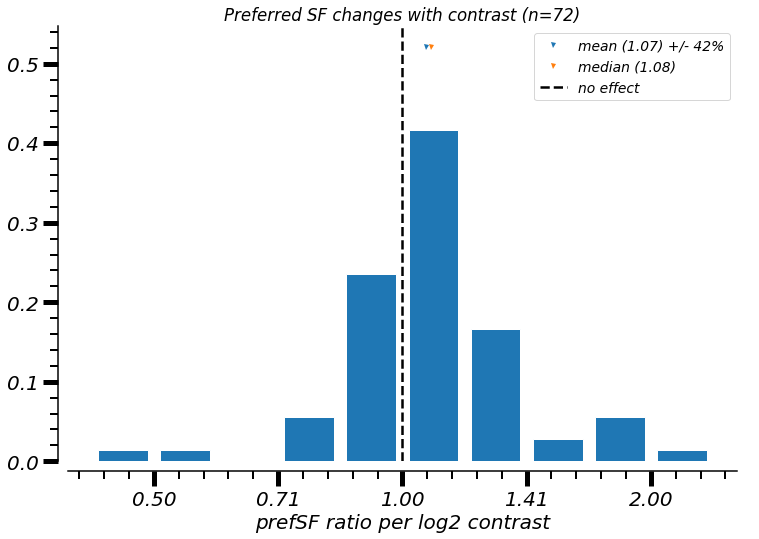

In [234]:
f = plt.figure(figsize=(12, 8))

vals, _ = np.histogram(psfClipped, bins=bins)
vals_norm = vals/np.sum(vals)
plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
mean, median = [np.nanmean(psfModRats), np.nanmedian(psfModRats)];
std = np.nanstd(psfModRats);
stdAsRatio = std/np.power(2, mean);
plt.plot(mean, 1.25*np.max(vals_norm), 'v', label='mean (%.2f) +/- %.0f%%' % (np.power(2, mean), 100*stdAsRatio));
plt.plot(median, 1.25*np.max(vals_norm), 'v', label='median (%.2f)' % np.power(2, median));
plt.axvline(0, ls='--', c='k', label='no effect')
plt.legend(fontsize='x-small');
plt.xticks(tickVals, ['%.2f' % np.power(2, x) for x in tickVals]);
plt.xlabel('prefSF ratio per log2 contrast');
plt.title('Preferred SF changes with contrast (n=%d)' % sum(vals), fontsize='small');
sns.despine(offset=10)

if not os.path.exists(save_loc):
    os.makedirs(save_loc)
pdfSv = pltSave.PdfPages(save_loc + saveName);
pdfSv.savefig(f) # only one figure here...
pdfSv.close()

In [239]:
np.power(2, tickVals)

array([0.5       , 0.70710678, 1.        , 1.41421356, 2.        ])

In [240]:
np.power(2, binPlotLocs)

array([0.45850202, 0.54525387, 0.64841978, 0.77110541, 0.91700404,
       1.09050773, 1.29683955, 1.54221083, 1.83400809, 2.18101547])

...aside: suppose want to look at cells where the ratio shift is in the top 25% (i.e. highest):

In [102]:
nan_rm = lambda x: x[~np.isnan(x)]

prctile = 75;
thresh = np.percentile(nan_rm(psfRats), prctile)
# thresh = np.percentile(np.abs(nan_rm(psfRats)), prctile)
shiftCells = np.where(psfRats>thresh)[0]

allChiDiffs = [];

for i in shiftCells:
    currEntry = jointList[i];
    currName = currEntry['metadata']['expName'];
    try:
        flat, wght = currEntry['model']['NLL_flat'], currEntry['model']['NLL_wght'];
        chiSqDiff = flat-wght;
        allChiDiffs.append(chiSqDiff);
        print('%s: flat|wght is (%.2f|%.2f)' % (currName, flat, wght));
    except: # no fit for this cell
        pass
    
sns.distplot(allChiDiffs, kde=False);
sns.despine(offset=10);

NameError: name 'pSfModRats' is not defined

#### Preferred spatial frequency with contrast from data, 1:.33 contrast

In [103]:
saveName = 'sfFixConRatioNorm_%s.pdf' % fitBase;

# get psfRatio 1:.33 contrast (raw value, not norm. to con value)
toNorm = 0;
if toNorm == 1:
    conNorm = np.log2(1/0.33);
else:
    conNorm = 1;
    
psfRats = [jointList[i]['metrics']['diffsAtThirdCon'][2]/conNorm for i in range(len(jointList))];
psfRats = np.array(psfRats);

bins = np.linspace(-1.25, 1.25, 11);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
psfClipped = np.clip(psfRats, bins[0]+0.5*stepSize, bins[-1]-0.5*stepSize)

tickVals = np.linspace(bins[1], bins[-2], 5);

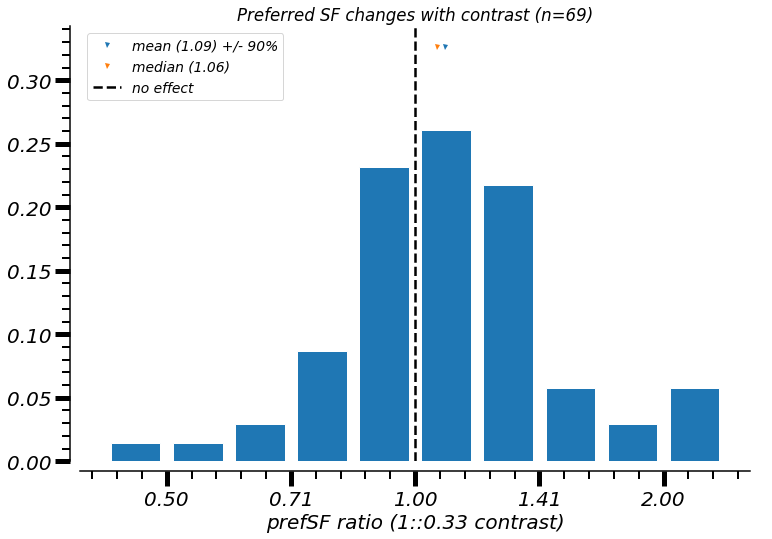

In [104]:
f = plt.figure(figsize=(12, 8))

vals, _ = np.histogram(psfClipped, bins=bins)
vals_norm = vals/np.sum(vals)
plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
mean, median = [np.nanmean(psfRats), np.nanmedian(psfRats)];
std = np.nanstd(pSfRats);
stdAsRatio = std/np.power(2, mean);
plt.plot(mean, 1.25*np.max(vals_norm), 'v', label='mean (%.2f) +/- %.0f%%' % (np.power(2, mean), 100*stdAsRatio));
plt.plot(median, 1.25*np.max(vals_norm), 'v', label='median (%.2f)' % np.power(2, median));
plt.axvline(0, ls='--', c='k', label='no effect')
plt.legend(fontsize='x-small', loc='upper left');
plt.xticks(tickVals, ['%.2f' % np.power(2, x) for x in tickVals]);
plt.xlabel('prefSF ratio (1::0.33 contrast)');
plt.title('Preferred SF changes with contrast (n=%d)' % sum(vals), fontsize='small');
sns.despine(offset=10)

if not os.path.exists(save_loc):
    os.makedirs(save_loc)
pdfSv = pltSave.PdfPages(save_loc + saveName);
pdfSv.savefig(f) # only one figure here...
pdfSv.close()

#### Bandwidth with contrast from data, 1:.33 contrast

In [105]:
saveBase = lambda s: 'bwFixedCons%s_%s.pdf' % (s, fitBase);

# get bw diff 1:.33 contrast (raw value, not norm. to con value)
bwAt = 1; # 0 - half-height; 1 - 3/4 height

bwStr = ['1/2 ht', '3/4 ht'];
bwSaveStr = ['_hh', '_3qh'];

bwDiff = [jointList[i]['metrics']['diffsAtThirdCon'][bwAt] for i in range(len(jointList))];
bwDiff = np.array(bwDiff);

bins = np.linspace(-2.5, 2.5, 11);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
bwClipped = np.clip(bwDiff, bins[0]+0.5*stepSize, bins[-1]-0.5*stepSize)

tickVals = np.linspace(bins[1], bins[-2], 5);

In [106]:
np.argsort(bwDiff)

array([60, 68, 71, 78, 67, 73, 70, 16, 57,  1, 30, 69, 77, 17, 38, 20, 45,
       11, 29,  4, 56, 13, 40,  5, 15, 54,  0,  6, 10, 55, 41, 35, 27, 19,
       59, 47, 34, 39, 28, 64,  3, 63, 62, 25, 51, 21, 37,  9, 32,  7,  2,
       83,  8, 44, 42, 58, 43, 61, 72, 12, 31, 33, 49, 65, 36, 76, 79, 80,
       81, 75, 74, 26, 52, 14, 50, 66, 46, 48, 22, 23, 24, 53, 82, 18])

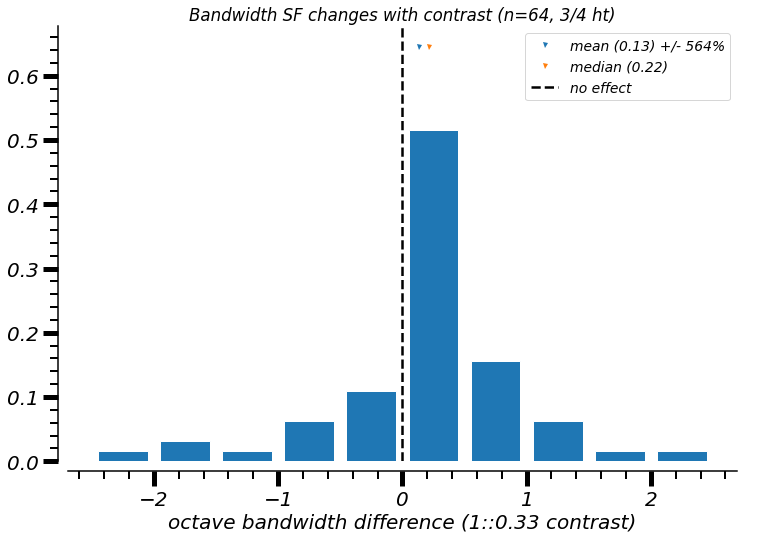

In [108]:
f = plt.figure(figsize=(12, 8))

vals, _ = np.histogram(bwClipped, bins=bins)
vals_norm = vals/np.sum(vals)
plt.bar(binPlotLocs, vals_norm, width=0.8*stepSize, align='center');
mean, median = [np.nanmean(bwDiff), np.nanmedian(bwDiff)];
std = np.nanstd(bwClipped);
# stdAsRatio = 0
stdAsRatio = std/mean;
plt.plot(mean, 1.25*np.max(vals_norm), 'v', label='mean (%.2f) +/- %.0f%%' % (mean, 100*stdAsRatio));
plt.plot(median, 1.25*np.max(vals_norm), 'v', label='median (%.2f)' % median);
plt.axvline(0, ls='--', c='k', label='no effect')
plt.legend(fontsize='x-small');
plt.xlabel('octave bandwidth difference (1::0.33 contrast)');
plt.title('Bandwidth SF changes with contrast (n=%d, %s)' % (sum(vals), bwStr[bwAt]), fontsize='small');
sns.despine(offset=10)

if not os.path.exists(save_loc):
    os.makedirs(save_loc)
saveName = saveBase(bwSaveStr[bwAt])
pdfSv = pltSave.PdfPages(save_loc + saveName);
pdfSv.savefig(f) # only one figure here...
pdfSv.close()

### plot distribution of loss values

In [ ]:
nan_rm = lambda x: x[~np.isnan(x)]

In [ ]:
bins = np.linspace(-16, 16, 9);

In [ ]:
bins

In [ ]:
# for chiSq distribution plot
bins = np.linspace(-17.5, 17.5, 15);
stepSize = (bins[-1] - bins[0])/(len(bins)-1);
binPlotLocs = bins[1:] - 0.5*stepSize;
chiSqClipped = np.clip(chi_diff, bins[0]+0.5*stepSize, bins[-1]-0.5*stepSize)

tickVals = np.linspace(bins[1], bins[-2], 7);

In [ ]:
tickVals

In [ ]:
saveName = 'chiSq_%s.pdf' % fitBase

chiSq = dict();
chiSq['flat'] = np.array([jointList[i]['model']['NLL_flat'] for i in range(len(jointList))])
chiSq['wght'] = np.array([jointList[i]['model']['NLL_wght'] for i in range(len(jointList))])

chi_diff = chiSq['flat'] - chiSq['wght']

width=3.5;

f, ax = plt.subplots(1, 3, figsize=(40, 10), sharey=False)

# plot chi^2 values (un-normalized)
ax[0].scatter(chiSq['flat'], chiSq['wght'])
ax[0].loglog([1e-0, 1e2], [1e-0, 1e2], 'k--')
ax[0].axis('equal')
ax[0].set_xlabel(r'flat $\chi^2$');
ax[0].set_ylabel(r'wght $\chi^2$');
ax[0].set_title('n = %d|%d (flat|weight)' % (len(nan_rm(chiSq['flat'])), len(nan_rm(chiSq['wght']))))

# plot >0 and <0 separately
lt0 = chi_diff[chi_diff<0]
gt0 = chi_diff[chi_diff>0]
ax[1].plot(1+np.arange(len(lt0)), np.sort(lt0), 'o', color='r')
ax[1].plot(len(lt0)+np.arange(len(gt0)), np.sort(gt0), 'o', color='k')
ax[1].axhline(0, ls='--', color='k');
ax[1].set_ylabel(r'$\chi^2$');
ax[1].set_xlabel('(ordered) cell');

# plot chi^2 values (un-normalized)
width = 2
counts, hist = np.histogram(nan_rm(chiSqClipped), bins=bins);
ax[2].axvline(0, ls='--', color='k')
sigCrit = 5.991; # magic number...from chi^2 dist, p<0.5
ax[2].bar(hist[0:-1], counts/len(nan_rm(chiSqClipped)), width=width, align='edge', label='%d-vs-%d sig.' % (np.sum(chi_diff>sigCrit), np.sum(chi_diff<-sigCrit)));
ax[2].set_title('mean|median (n): %.3f, %.3f (n=%d)' % (np.nanmean(chi_diff), np.nanmedian(chi_diff), len(nan_rm(chi_diff))));
ax[2].legend(fontsize='small');
ax[2].set_xlabel(r'$\chi^2 (flat - tuned)$');
ax[2].set_ylabel('proportion of cells');
ax[2].set_xlim([bins[0], bins[-1]])
ax[2].set_xticks(tickVals);

# # plot normalized chi^2 differences
# width = 0.3
# chi_diff = chiSq['flat_norm'] - chiSq['wght_norm']
# bins = np.linspace(0, 5, 15);
# counts, hist = np.histogram(chi_diff, bins=bins);
# ax[2].axvline(0, ls='--', color='k')
# ax[2].bar(bins[0:-1], counts/len(chi_diff), width=width, align='edge');
# ax[2].legend();
# ax[2].set_xlabel(r'$(norm.) \chi^2 (flat - tuned)$');
# ax[2].set_ylabel('proportion of cells');

plt.suptitle('Comparing models: %s' % fitBase);

if not os.path.exists(save_loc):
    os.makedirs(save_loc)
pdfSv = pltSave.PdfPages(save_loc + saveName);
pdfSv.savefig(f) # only one figure here...
pdfSv.close()

### plot pSf ratio against exc/norm filter ratio...

In [ ]:
# the following is only for weighted normalization!
sfRatToUse = psfModRats; # mod ratios or from-data ratios?

c50_loc = 2;

modParamRatio = lambda params: params[0]/np.power(10, params[-2]) if params != [] else np.nan; # it's second to last parameter
modExcNormRat = [modParamRatio(jointList[x]['model']['params_wght']) for x in range(len(jointList))]
getC50 = lambda params: params[c50_loc] if params != [] else np.nan; 
c50s = np.array([getC50(jointList[x]['model']['params_wght']) for x in range(len(jointList))]);
zTO1 = lambda x: np.divide(x - np.nanmin(x), np.nanmax(x - np.nanmin(x)));

In [ ]:
jointList[21]['metadata']

In [ ]:
modExcNormRat[58]

In [ ]:
np.argsort(modExcNormRat)

In [ ]:
plt.semilogy(np.clip(modExcNormRat, np.power(10, -2.0), np.power(10, 2)), 'o');

In [ ]:
val_inds = np.logical_and(~np.isnan(sfRatToUse), ~np.isnan(np.log2(modExcNormRat)));
c50_color = cm.gray(zTO1(np.clip(c50s[val_inds], -2, 1)));
plt.scatter(sfRatToUse[val_inds], np.clip(np.log2(np.array(modExcNormRat)[val_inds]), -2, 2), marker='o', color=c50_color);
plt.xlabel('data contrast shift');
plt.ylabel('model exc/norm ratio');

In [ ]:
### STATISTICAL TEST??
nan_rm = lambda x: x[~np.isnan(x)]
ttest_1samp(nan_rm(psfRats), 0)

Below this is older analyses - still good, but not my newest for VSS

In [ ]:
height = 3/4; # measure BW at half-height
sf_range = [0.01, 10]; # allowed values of 'mu' for fits - see descr_fit.py for details

In [ ]:
### sf tuning
descrExp = hf.np_smart_load(data_loc + descrName)
# HACKY: Just setting to descrFits on exp data...
descrMod = hf.np_smart_load(data_loc + descrName)
# descrMod = np.load(data_loc + descrModName, encoding='latin1').item()

### rvc
rvcExp = hf.np_smart_load(data_loc + rvcName)
# HACKY: Just setting to descrFits on exp data...
rvcMod = hf.np_smart_load(data_loc + rvcName)

In [ ]:
modParams = np.load(data_loc + fitName, encoding='latin1').item();

## Get bandwidth/prefSf measures organized

In [87]:
# get experiment parameters/organization
nCells = len(jointList)

maxComp = np.zeros((3,), dtype=int); # i.e.

for f in dataList['unitName']:

    cell = hf.np_smart_load(data_loc + f + '_sfm.npy');
    expInd = hf.get_exp_ind(data_loc, f)[0];
    _, stimVals, val_con_by_disp, _, _ = hf.tabulate_responses(cell, expInd);

    for currComp, i in zip(stimVals, range(len(stimVals))):
        if len(currComp) > maxComp[i]:
            maxComp[i] = len(currComp);

# now we know the maximum number of dispersions, sfs, and contrasts

In [90]:
nFamiliesMax, nConsMax, nSfsMax = maxComp;

bwMod = np.zeros((nCells, nFamiliesMax, nConsMax)) * np.nan;
bwExp = np.zeros((nCells, nFamiliesMax, nConsMax)) * np.nan;

pSfMod = np.zeros((nCells, nFamiliesMax, nConsMax)) * np.nan;
pSfExp = np.zeros((nCells, nFamiliesMax, nConsMax)) * np.nan;

c50Mod = np.zeros((nCells, nFamiliesMax, nSfsMax)) * np.nan
c50Exp = np.zeros((nCells, nFamiliesMax, nSfsMax)) * np.nan

In [ ]:
for i in descrExp:
    for f in range(nFamilies):
        # spatial frequency stuff
        for c in range(nCons):
        
            if i in descrExp:
                try:
                    # on data
                    ignore, bwExp[i, f, c] = hf.compute_SF_BW(descrExp[i]['params'][f, c, :], height, sf_range)
                    pSfExp[i, f, c] = descrExp[i]['params'][f, c, muLoc]
                except: # then this dispersion does not have that contrast value, but it's ok - we already have nan
                    pass 

            if i in descrMod:
                try:
                    # on model
                    ignore, bwMod[i, f, c] = hf.compute_SF_BW(descrMod[i]['params'][f, c, :], height, sf_range)
                    pSfMod[i, f, c] = descrMod[i]['params'][f, c, muLoc]
                except: # then this dispersion does not have that contrast value, but it's ok - we already have nan
                    pass

        # RVC stuff
        for s in range(nSfs):
            if i in rvcExp:
                # on data
                try:
                    c50Exp[i, f, s] = rvcExp[i]['params'][f, s, c50Loc];
                except: # then this dispersion does not have that SF value, but it's ok - we already have nan
                    pass
                
            if i in rvcMod:
                # on model
                try:
                    c50Mod[i, f, s] = rvcMod[i]['params'][f, s, c50Loc];
                except: # then this dispersion does not have that SF value, but it's ok - we already have nan
                    pass

In [ ]:
bwModRats = np.zeros((nCells, nFamilies, nCons, nCons)) * np.nan;
bwExpRats = np.zeros((nCells, nFamilies, nCons, nCons)) * np.nan;

pSfModRats = np.zeros((nCells, nFamilies, nCons, nCons)) * np.nan;
pSfExpRats = np.zeros((nCells, nFamilies, nCons, nCons)) * np.nan;

c50ModRats = np.zeros((nCells, nFamilies, nSfs, nSfs)) * np.nan;
c50ExpRats = np.zeros((nCells, nFamilies, nSfs, nSfs)) * np.nan;

In [ ]:
for i in descrExp:
    for f in range(nFamilies):
        # as function of contrast
        for comb in itertools.combinations(range(nCons), 2):
            bwModRats[i,f,comb[0],comb[1]] = bwMod[i,f,comb[1]] - bwMod[i,f,comb[0]]
            bwExpRats[i,f,comb[0],comb[1]] = bwExp[i,f,comb[1]] - bwExp[i,f,comb[0]]

            pSfModRats[i,f,comb[0],comb[1]] = pSfMod[i,f,comb[1]] / pSfMod[i,f,comb[0]]
            pSfExpRats[i,f,comb[0],comb[1]] = pSfExp[i,f,comb[1]] / pSfExp[i,f,comb[0]]

        # as function of SF
        for comb in itertools.permutations(range(nSfs), 2):
            c50ModRats[i,f,comb[0],comb[1]] = c50Mod[i,f,comb[1]] / c50Mod[i,f,comb[0]]
            c50ExpRats[i,f,comb[0],comb[1]] = c50Exp[i,f,comb[1]] / c50Exp[i,f,comb[0]]

### Organize model-derived ratio

Rather than taking just the data, we can restrict ourselves to well-fit (i.e. varExpl > a set threshold) tuning curves; read off the variable of interest (e.g. prefSf) for that curve, and fit a model to the progression of that variable with , e.g. contrast -- finally, read off the variable of interest from the model, rather than just the point/discrete values

In [ ]:
### Plot + compute pSfRatio in a model-derived way (i.e. use all prefSfs at different cons, fit a model and read off)
# for individual cell

varThresh = 80;
cellNum = 4;
disp = 0;

name = dataList['unitName'][cellNum-1];
expInd = hf.get_exp_ind(data_loc, name)[0];
cell = hf.np_smart_load(data_loc + name + '_sfm.npy')
_, stimVals, val_con_by_disp, _, _ = hf.tabulate_responses(cell, expInd);
all_cons = stimVals[1];
nFamilies = len(stimVals[0]);


pSfRatio, psf_model, opt_params = hf.dog_prefSfMod(descrExp[cellNum-1], allCons=all_con, disp=disp, varThresh=varThresh, dog_model=0)

valInds = np.where(descrExp[cellNum-1]['varExpl'][disp, :] > varThresh)[0];
logConRat = np.log2(all_con[valInds[-1]]/all_con[valInds[0]]);
plt.plot(all_con, psf_model(*opt_params, con=all_con))
plt.plot(all_con[valInds], pSfExp[cellNum-1, disp, valInds], 'o')
plt.title('Ratio at extremes: %.2f, or %.2f per log(2) contrast step' % (pSfRatio, pSfRatio/logConRat));

In [ ]:
### Compute pSfRatio in a model-derived way (i.e. use all prefSfs at different cons, fit a model and read off)

varThresh = 80;
pSfDerivRats = np.zeros((nCells, nFamilies, 2)) * np.nan

for f, ind in zip(dataList['unitName'], range(nCells)):
    
    expInd = hf.get_exp_ind(data_loc, f)[0];
    cell = hf.np_smart_load(data_loc + f + '_sfm.npy')
    _, stimVals, val_con_by_disp, _, _ = hf.tabulate_responses(cell, expInd);
    all_cons = stimVals[1];
    nFamilies = len(stimVals[0]);
    
    for disp in range(nFamilies):

        try:
            pSfRatio, psf_model, opt_params = hf.dog_prefSfMod(descrExp[ind], allCons=all_con, disp=disp, varThresh=varThresh, dog_model=0)

            valInds = np.where(descrExp[ind]['varExpl'][disp, :] > varThresh)[0];
            logConRat = np.log2(all_con[valInds[-1]]/all_con[valInds[0]]);

            pSfDerivRats[ind, disp, :] = [pSfRatio, np.log2(pSfRatio)/logConRat]
        except:
            pass # then either fit doesn't exist or no SF descr fits passed thresh; we've already initialized to nan

In [ ]:
f, ax = plt.subplots(2, nFamiliesMax, figsize=(10*nFamiliesMax, 12));

binsRat = np.linspace(-4,4,9)
binsUnit = np.linspace(-4,4,9)

for i in range(nFamiliesMax):

    nonNan = np.where(~np.isnan(pSfDerivRats[:, i, 0]))
    ax[0, i].hist(np.clip(np.log2(pSfDerivRats[nonNan, i, 0][0]), binsRat[0], binsRat[-1]), bins=binsRat, rwidth=0.9)
    if i == 0:
        ax[0, i].set_xlabel('Ratio of prefSf at highest to lowest contrast')
    
    ax[1, i].hist(np.clip(pSfDerivRats[nonNan, i, 1][0], binsUnit[0], binsUnit[-1]), bins=binsUnit, rwidth=0.9)
    if i == 0:
        ax[1, i].set_xlabel(r'log $\Delta$ prefSf per unit log contrast')

sns.despine(offset=10)

### Ratio plots as matricies (i.e. all relevant pairwise ratios)

Now, we compute all pairwise combinations so that we can compute the ratios/differences of these measures.
- For the pSf/BW, which we measure at distinct contrasts, we want to take the ratio as relative to the higher contrast, which is the larger index into all_cons
- For the c50 measure, this is a function of SF; we'll eventually want to take the ratios relative to the preferred (or closest-to-preferred) SF

In [ ]:
pSfExp.shape

In [ ]:
pSfExp[ind, 0, -1]

### now, example "upper diag plots"

In [ ]:

cellNum = 17;
dispInd = 0;

cell = hf.np_smart_load(data_loc + dataList['unitName'][cellNum-1] + '_sfm.npy');
expInd = hf.get_exp_ind(data_loc, dataList['unitName'][cellNum-1])[0];
_, stimVals, val_con_by_disp, _, _ = hf.tabulate_responses(cell, expInd);
all_disp, all_con, all_sf = stimVals;

metrics = [bwExpRats, pSfExpRats, c50ExpRats];
metricNames = ['bandwidth difference (oct)', 'prefSf ratio', 'c50 ratio'];
metricUnits = ['(con %)', '(con %)', '(sf cpd)']
metricScales = [all_con, all_con, all_sf];
metricLog    = [0, 1, 1]; # do not log bw diff, but log other measures
metricRef    = [0, 1, 1]; # what is the reference value
nPlots = len(metrics);

f, ax = plt.subplots(2, nPlots, figsize=(15*nPlots, 2*12))

for m, mn, ms, mu, ml, mr, ind in zip(metrics, metricNames, metricScales, metricUnits, metricLog, metricRef, range(nPlots)):

    ### First, the overall summaries
    if ml == 1:
        imCurr = ax[0, ind].imshow(np.log2(m[cellNum-1, dispInd, :, :]));
    elif ml == 0:
        imCurr = ax[0, ind].imshow(m[cellNum-1, dispInd, :, :]);
    ax[0, ind].set_xlabel('reference %s' % mu)
    ax[0, ind].set_ylabel('test')
    # find out which are valid indices
    valids = np.where(np.any(~np.isnan(m[cellNum-1, dispInd, :, :]), 0))[0]
    ax[0, ind].xaxis.set_ticks(valids)
    ax[0, ind].yaxis.set_ticks(valids)
    ax[0, ind].xaxis.set_ticklabels(['%.2f' % x for x in ms[valids]], rotation='30')
    ax[0, ind].yaxis.set_ticklabels(['%.2f' % x for x in ms[valids]], rotation='30')
    f.colorbar(imCurr, ax=ax[0, ind]);
    ax[0, ind].set_title('%s' % mn);
    
    ### Then, the ratio plots for the "preferred" case (i.e. highest con, peakSf)
    # all of the plots here should be w.r.t. log(x)
    if np.all(ms == all_sf): # find peak SF...
        peakSf = pSfExp[ind, dispInd, val_con_by_disp[dispInd][-1]]; # i.e. highest contrast
        peakInd = np.argmin(np.square(ms[valids] - peakSf));
        peakInd = valids[peakInd];
    else:
        peakInd = valids[-1]; # i.e. the highest contrast
    if ml == 1:
        ax[1, ind].loglog(ms[valids], m[cellNum-1, dispInd, valids, peakInd], 'o-')
    elif ml == 0:
        ax[1, ind].semilogx(ms[valids], m[cellNum-1, dispInd, valids, peakInd], 'o-')
    # set the reference line
    ax[1, ind].axhline(mr, linestyle='--')
    # set the axes...
    ax[1, ind].xaxis.set_ticks(ms[valids])
    ax[1, ind].xaxis.set_ticklabels(['%.2f' % x for x in ms[valids]], rotation='30')
    # labels
    ax[1, ind].set_xlabel('test (ref: %.2f) %s' % (ms[peakInd], mu))
    ax[1, ind].set_ylabel('%s (ref:test)' % mn)
    
f.suptitle('Changes with contrast: cell %d, dispersion %d' % (cellInd, dispInd));

In [ ]:
# from the old way...
bwDiffMod = bwMod[:, :, conInd[1]] - bwMod[:,:, conInd[0]]
bwDiffExp = bwExp[:, :, conInd[1]] - bwExp[:,:, conInd[0]]

pSfRatioMod = pSfMod[:, :, conInd[1]] / pSfMod[:,:, conInd[0]]
pSfRatioExp = pSfExp[:, :, conInd[1]] / pSfExp[:,:, conInd[0]]